# Session (466029_f3_stage2_day13)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day13" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day13"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35248, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


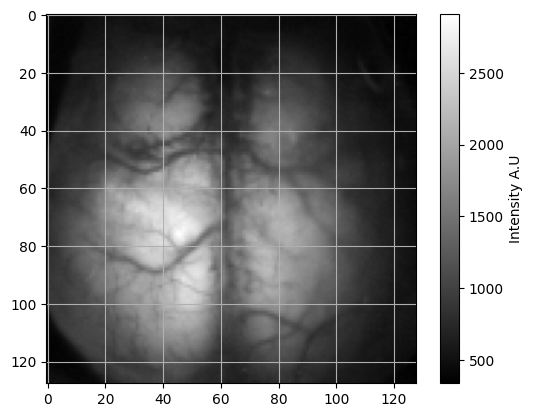

frame number 6000 plotted


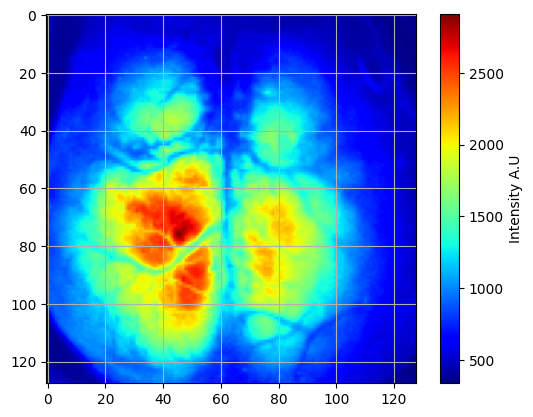

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 361.4621337890625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 406.6449005126953


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 54
Number of double_flash pairs: 27
Number of single_flash: 55
Number of total flashes: 109


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/109 [00:00<?, ?it/s]

  1%|▊                                                                                 | 1/109 [00:01<02:33,  1.42s/it]

  2%|█▌                                                                                | 2/109 [00:02<02:27,  1.38s/it]

  3%|██▎                                                                               | 3/109 [00:04<02:26,  1.39s/it]

  4%|███                                                                               | 4/109 [00:05<02:25,  1.38s/it]

  5%|███▊                                                                              | 5/109 [00:06<02:24,  1.39s/it]

  6%|████▌                                                                             | 6/109 [00:08<02:25,  1.41s/it]

  6%|█████▎                                                                            | 7/109 [00:09<02:22,  1.40s/it]

  7%|██████                                                                            | 8/109 [00:11<02:21,  1.40s/it]

  8%|██████▊                                                                           | 9/109 [00:12<02:18,  1.38s/it]

  9%|███████▍                                                                         | 10/109 [00:13<02:18,  1.40s/it]

 10%|████████▏                                                                        | 11/109 [00:15<02:15,  1.38s/it]

 11%|████████▉                                                                        | 12/109 [00:16<02:15,  1.40s/it]

 12%|█████████▋                                                                       | 13/109 [00:17<02:09,  1.35s/it]

 13%|██████████▍                                                                      | 14/109 [00:19<02:06,  1.33s/it]

 14%|███████████▏                                                                     | 15/109 [00:20<02:06,  1.34s/it]

 15%|███████████▉                                                                     | 16/109 [00:21<02:05,  1.35s/it]

 16%|████████████▋                                                                    | 17/109 [00:23<02:02,  1.33s/it]

 17%|█████████████▍                                                                   | 18/109 [00:24<02:00,  1.33s/it]

 17%|██████████████                                                                   | 19/109 [00:25<01:58,  1.32s/it]

 18%|██████████████▊                                                                  | 20/109 [00:27<01:58,  1.33s/it]

 19%|███████████████▌                                                                 | 21/109 [00:28<01:58,  1.34s/it]

 20%|████████████████▎                                                                | 22/109 [00:30<01:59,  1.38s/it]

 21%|█████████████████                                                                | 23/109 [00:31<01:54,  1.33s/it]

 22%|█████████████████▊                                                               | 24/109 [00:32<01:53,  1.34s/it]

 23%|██████████████████▌                                                              | 25/109 [00:33<01:52,  1.33s/it]

 24%|███████████████████▎                                                             | 26/109 [00:35<01:51,  1.35s/it]

 25%|████████████████████                                                             | 27/109 [00:36<01:49,  1.34s/it]

 26%|████████████████████▊                                                            | 28/109 [00:38<01:51,  1.37s/it]

 27%|█████████████████████▌                                                           | 29/109 [00:39<01:50,  1.38s/it]

 28%|██████████████████████▎                                                          | 30/109 [00:40<01:48,  1.37s/it]

 28%|███████████████████████                                                          | 31/109 [00:42<01:47,  1.37s/it]

 29%|███████████████████████▊                                                         | 32/109 [00:43<01:44,  1.35s/it]

 30%|████████████████████████▌                                                        | 33/109 [00:44<01:40,  1.32s/it]

 31%|█████████████████████████▎                                                       | 34/109 [00:46<01:39,  1.32s/it]

 32%|██████████████████████████                                                       | 35/109 [00:47<01:39,  1.34s/it]

 33%|██████████████████████████▊                                                      | 36/109 [00:48<01:38,  1.35s/it]

 34%|███████████████████████████▍                                                     | 37/109 [00:50<01:37,  1.36s/it]

 35%|████████████████████████████▏                                                    | 38/109 [00:51<01:37,  1.37s/it]

 36%|████████████████████████████▉                                                    | 39/109 [00:52<01:34,  1.35s/it]

 37%|█████████████████████████████▋                                                   | 40/109 [00:54<01:30,  1.31s/it]

 38%|██████████████████████████████▍                                                  | 41/109 [00:55<01:30,  1.33s/it]

 39%|███████████████████████████████▏                                                 | 42/109 [00:56<01:27,  1.30s/it]

 39%|███████████████████████████████▉                                                 | 43/109 [00:58<01:26,  1.31s/it]

 40%|████████████████████████████████▋                                                | 44/109 [00:59<01:28,  1.36s/it]

 41%|█████████████████████████████████▍                                               | 45/109 [01:00<01:27,  1.36s/it]

 42%|██████████████████████████████████▏                                              | 46/109 [01:02<01:23,  1.33s/it]

 43%|██████████████████████████████████▉                                              | 47/109 [01:03<01:23,  1.35s/it]

 44%|███████████████████████████████████▋                                             | 48/109 [01:04<01:20,  1.33s/it]

 45%|████████████████████████████████████▍                                            | 49/109 [01:06<01:18,  1.31s/it]

 46%|█████████████████████████████████████▏                                           | 50/109 [01:07<01:17,  1.31s/it]

 47%|█████████████████████████████████████▉                                           | 51/109 [01:08<01:16,  1.33s/it]

 48%|██████████████████████████████████████▋                                          | 52/109 [01:10<01:16,  1.33s/it]

 49%|███████████████████████████████████████▍                                         | 53/109 [01:11<01:15,  1.35s/it]

 50%|████████████████████████████████████████▏                                        | 54/109 [01:12<01:14,  1.36s/it]

 50%|████████████████████████████████████████▊                                        | 55/109 [01:14<01:15,  1.39s/it]

 51%|█████████████████████████████████████████▌                                       | 56/109 [01:15<01:12,  1.37s/it]

 52%|██████████████████████████████████████████▎                                      | 57/109 [01:17<01:11,  1.37s/it]

 53%|███████████████████████████████████████████                                      | 58/109 [01:18<01:10,  1.38s/it]

 54%|███████████████████████████████████████████▊                                     | 59/109 [01:19<01:08,  1.37s/it]

 55%|████████████████████████████████████████████▌                                    | 60/109 [01:21<01:05,  1.34s/it]

 56%|█████████████████████████████████████████████▎                                   | 61/109 [01:22<01:03,  1.33s/it]

 57%|██████████████████████████████████████████████                                   | 62/109 [01:23<01:02,  1.33s/it]

 58%|██████████████████████████████████████████████▊                                  | 63/109 [01:25<01:01,  1.34s/it]

 59%|███████████████████████████████████████████████▌                                 | 64/109 [01:26<01:00,  1.36s/it]

 60%|████████████████████████████████████████████████▎                                | 65/109 [01:27<00:59,  1.36s/it]

 61%|█████████████████████████████████████████████████                                | 66/109 [01:29<00:57,  1.35s/it]

 61%|█████████████████████████████████████████████████▊                               | 67/109 [01:30<00:57,  1.36s/it]

 62%|██████████████████████████████████████████████████▌                              | 68/109 [01:31<00:55,  1.35s/it]

 63%|███████████████████████████████████████████████████▎                             | 69/109 [01:33<00:53,  1.33s/it]

 64%|████████████████████████████████████████████████████                             | 70/109 [01:34<00:51,  1.33s/it]

 65%|████████████████████████████████████████████████████▊                            | 71/109 [01:35<00:50,  1.34s/it]

 66%|█████████████████████████████████████████████████████▌                           | 72/109 [01:37<00:48,  1.31s/it]

 67%|██████████████████████████████████████████████████████▏                          | 73/109 [01:38<00:47,  1.32s/it]

 68%|██████████████████████████████████████████████████████▉                          | 74/109 [01:39<00:46,  1.33s/it]

 69%|███████████████████████████████████████████████████████▋                         | 75/109 [01:41<00:45,  1.33s/it]

 70%|████████████████████████████████████████████████████████▍                        | 76/109 [01:42<00:45,  1.37s/it]

 71%|█████████████████████████████████████████████████████████▏                       | 77/109 [01:44<00:44,  1.39s/it]

 72%|█████████████████████████████████████████████████████████▉                       | 78/109 [01:45<00:42,  1.38s/it]

 72%|██████████████████████████████████████████████████████████▋                      | 79/109 [01:46<00:41,  1.37s/it]

 73%|███████████████████████████████████████████████████████████▍                     | 80/109 [01:48<00:39,  1.36s/it]

 74%|████████████████████████████████████████████████████████████▏                    | 81/109 [01:49<00:37,  1.36s/it]

 75%|████████████████████████████████████████████████████████████▉                    | 82/109 [01:50<00:36,  1.37s/it]

 76%|█████████████████████████████████████████████████████████████▋                   | 83/109 [01:52<00:34,  1.33s/it]

 77%|██████████████████████████████████████████████████████████████▍                  | 84/109 [01:53<00:33,  1.32s/it]

 78%|███████████████████████████████████████████████████████████████▏                 | 85/109 [01:54<00:31,  1.33s/it]

 79%|███████████████████████████████████████████████████████████████▉                 | 86/109 [01:56<00:30,  1.34s/it]

 80%|████████████████████████████████████████████████████████████████▋                | 87/109 [01:57<00:29,  1.36s/it]

 81%|█████████████████████████████████████████████████████████████████▍               | 88/109 [01:59<00:29,  1.39s/it]

 82%|██████████████████████████████████████████████████████████████████▏              | 89/109 [02:00<00:27,  1.37s/it]

 83%|██████████████████████████████████████████████████████████████████▉              | 90/109 [02:01<00:25,  1.35s/it]

 83%|███████████████████████████████████████████████████████████████████▌             | 91/109 [02:03<00:24,  1.38s/it]

 84%|████████████████████████████████████████████████████████████████████▎            | 92/109 [02:04<00:23,  1.39s/it]

 85%|█████████████████████████████████████████████████████████████████████            | 93/109 [02:05<00:22,  1.38s/it]

 86%|█████████████████████████████████████████████████████████████████████▊           | 94/109 [02:07<00:20,  1.35s/it]

 87%|██████████████████████████████████████████████████████████████████████▌          | 95/109 [02:08<00:18,  1.33s/it]

 88%|███████████████████████████████████████████████████████████████████████▎         | 96/109 [02:09<00:17,  1.35s/it]

 89%|████████████████████████████████████████████████████████████████████████         | 97/109 [02:11<00:16,  1.36s/it]

 90%|████████████████████████████████████████████████████████████████████████▊        | 98/109 [02:12<00:15,  1.37s/it]

 91%|█████████████████████████████████████████████████████████████████████████▌       | 99/109 [02:13<00:13,  1.38s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 100/109 [02:15<00:12,  1.38s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 101/109 [02:16<00:10,  1.37s/it]

 94%|██████████████████████████████████████████████████████████████████████████▊     | 102/109 [02:18<00:09,  1.36s/it]

 94%|███████████████████████████████████████████████████████████████████████████▌    | 103/109 [02:19<00:08,  1.34s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 104/109 [02:20<00:06,  1.35s/it]

 96%|█████████████████████████████████████████████████████████████████████████████   | 105/109 [02:22<00:05,  1.36s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▊  | 106/109 [02:23<00:04,  1.34s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 107/109 [02:24<00:02,  1.37s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 108/109 [02:26<00:01,  1.37s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 109/109 [02:27<00:00,  1.36s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 109/109 [02:27<00:00,  1.35s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▏                                                             | 29/128 [00:00<00:00, 284.41it/s]

 45%|████████████████████████████████████▎                                           | 58/128 [00:00<00:00, 274.71it/s]

 67%|█████████████████████████████████████████████████████▊                          | 86/128 [00:00<00:00, 272.27it/s]

 89%|██████████████████████████████████████████████████████████████████████▎        | 114/128 [00:00<00:00, 258.26it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 264.39it/s]

  0%|                                                                                        | 0/34271 [00:00<?, ?it/s]

  0%|                                                                              | 27/34271 [00:00<02:11, 260.41it/s]

  0%|▏                                                                             | 55/34271 [00:00<02:06, 270.25it/s]

  0%|▏                                                                             | 83/34271 [00:00<02:06, 271.02it/s]

  0%|▏                                                                            | 111/34271 [00:00<02:05, 272.83it/s]

  0%|▎                                                                            | 139/34271 [00:00<02:04, 273.35it/s]

  0%|▍                                                                            | 167/34271 [00:00<02:04, 272.87it/s]

  1%|▍                                                                            | 195/34271 [00:00<02:05, 272.56it/s]

  1%|▌                                                                            | 224/34271 [00:00<02:03, 274.61it/s]

  1%|▌                                                                            | 252/34271 [00:00<02:05, 270.49it/s]

  1%|▋                                                                            | 280/34271 [00:01<02:05, 271.74it/s]

  1%|▋                                                                            | 309/34271 [00:01<02:03, 274.76it/s]

  1%|▊                                                                            | 337/34271 [00:01<02:03, 275.53it/s]

  1%|▊                                                                            | 365/34271 [00:01<02:07, 265.06it/s]

  1%|▉                                                                            | 392/34271 [00:01<02:18, 245.24it/s]

  1%|▉                                                                            | 417/34271 [00:01<02:20, 240.56it/s]

  1%|█                                                                            | 446/34271 [00:01<02:14, 251.57it/s]

  1%|█                                                                            | 474/34271 [00:01<02:11, 257.43it/s]

  1%|█                                                                            | 500/34271 [00:01<02:12, 255.27it/s]

  2%|█▏                                                                           | 527/34271 [00:01<02:10, 258.78it/s]

  2%|█▏                                                                           | 554/34271 [00:02<02:09, 261.31it/s]

  2%|█▎                                                                           | 581/34271 [00:02<02:16, 247.24it/s]

  2%|█▎                                                                           | 606/34271 [00:02<02:22, 236.01it/s]

  2%|█▍                                                                           | 635/34271 [00:02<02:15, 248.31it/s]

  2%|█▍                                                                           | 661/34271 [00:02<02:15, 247.44it/s]

  2%|█▌                                                                           | 687/34271 [00:02<02:14, 250.34it/s]

  2%|█▌                                                                           | 714/34271 [00:02<02:11, 255.95it/s]

  2%|█▋                                                                           | 740/34271 [00:02<02:11, 254.93it/s]

  2%|█▋                                                                           | 766/34271 [00:02<02:14, 249.87it/s]

  2%|█▊                                                                           | 793/34271 [00:03<02:11, 254.24it/s]

  2%|█▊                                                                           | 820/34271 [00:03<02:09, 258.51it/s]

  2%|█▉                                                                           | 846/34271 [00:03<02:11, 254.49it/s]

  3%|█▉                                                                           | 872/34271 [00:03<02:11, 254.64it/s]

  3%|██                                                                           | 898/34271 [00:03<02:17, 242.05it/s]

  3%|██                                                                           | 923/34271 [00:03<02:18, 240.92it/s]

  3%|██▏                                                                          | 950/34271 [00:03<02:14, 248.53it/s]

  3%|██▏                                                                          | 978/34271 [00:03<02:10, 255.44it/s]

  3%|██▏                                                                         | 1004/34271 [00:03<02:19, 239.08it/s]

  3%|██▎                                                                         | 1029/34271 [00:04<02:17, 241.47it/s]

  3%|██▎                                                                         | 1057/34271 [00:04<02:11, 252.08it/s]

  3%|██▍                                                                         | 1083/34271 [00:04<02:16, 243.17it/s]

  3%|██▍                                                                         | 1108/34271 [00:04<02:21, 233.89it/s]

  3%|██▌                                                                         | 1132/34271 [00:04<02:21, 233.66it/s]

  3%|██▌                                                                         | 1156/34271 [00:04<02:25, 227.13it/s]

  3%|██▋                                                                         | 1184/34271 [00:04<02:18, 239.29it/s]

  4%|██▋                                                                         | 1209/34271 [00:04<02:18, 238.96it/s]

  4%|██▋                                                                         | 1235/34271 [00:04<02:15, 244.30it/s]

  4%|██▊                                                                         | 1260/34271 [00:04<02:16, 241.78it/s]

  4%|██▊                                                                         | 1287/34271 [00:05<02:12, 248.52it/s]

  4%|██▉                                                                         | 1315/34271 [00:05<02:09, 255.47it/s]

  4%|██▉                                                                         | 1341/34271 [00:05<02:14, 244.01it/s]

  4%|███                                                                         | 1366/34271 [00:05<02:14, 244.34it/s]

  4%|███                                                                         | 1391/34271 [00:05<02:16, 241.14it/s]

  4%|███▏                                                                        | 1416/34271 [00:05<02:15, 242.32it/s]

  4%|███▏                                                                        | 1441/34271 [00:05<02:21, 232.60it/s]

  4%|███▎                                                                        | 1468/34271 [00:05<02:15, 241.91it/s]

  4%|███▎                                                                        | 1496/34271 [00:05<02:10, 250.55it/s]

  4%|███▍                                                                        | 1522/34271 [00:06<02:13, 245.51it/s]

  5%|███▍                                                                        | 1547/34271 [00:06<02:13, 245.42it/s]

  5%|███▍                                                                        | 1572/34271 [00:06<02:13, 245.35it/s]

  5%|███▌                                                                        | 1599/34271 [00:06<02:10, 251.08it/s]

  5%|███▌                                                                        | 1625/34271 [00:06<02:21, 231.40it/s]

  5%|███▋                                                                        | 1652/34271 [00:06<02:15, 240.08it/s]

  5%|███▋                                                                        | 1677/34271 [00:06<02:17, 237.55it/s]

  5%|███▊                                                                        | 1705/34271 [00:06<02:11, 247.45it/s]

  5%|███▊                                                                        | 1733/34271 [00:06<02:07, 256.04it/s]

  5%|███▉                                                                        | 1759/34271 [00:07<02:13, 243.15it/s]

  5%|███▉                                                                        | 1786/34271 [00:07<02:09, 250.01it/s]

  5%|████                                                                        | 1814/34271 [00:07<02:06, 255.68it/s]

  5%|████                                                                        | 1841/34271 [00:07<02:05, 257.60it/s]

  5%|████▏                                                                       | 1868/34271 [00:07<02:04, 260.46it/s]

  6%|████▏                                                                       | 1895/34271 [00:07<02:04, 260.99it/s]

  6%|████▎                                                                       | 1923/34271 [00:07<02:01, 265.80it/s]

  6%|████▎                                                                       | 1950/34271 [00:07<02:06, 256.50it/s]

  6%|████▍                                                                       | 1976/34271 [00:07<02:09, 248.94it/s]

  6%|████▍                                                                       | 2001/34271 [00:07<02:14, 239.08it/s]

  6%|████▍                                                                       | 2026/34271 [00:08<02:18, 232.39it/s]

  6%|████▌                                                                       | 2052/34271 [00:08<02:14, 238.75it/s]

  6%|████▌                                                                       | 2076/34271 [00:08<02:18, 233.19it/s]

  6%|████▋                                                                       | 2104/34271 [00:08<02:11, 244.38it/s]

  6%|████▋                                                                       | 2131/34271 [00:08<02:08, 250.30it/s]

  6%|████▊                                                                       | 2157/34271 [00:08<02:07, 251.67it/s]

  6%|████▊                                                                       | 2183/34271 [00:08<02:12, 242.69it/s]

  6%|████▉                                                                       | 2210/34271 [00:08<02:08, 250.31it/s]

  7%|████▉                                                                       | 2237/34271 [00:08<02:06, 253.82it/s]

  7%|█████                                                                       | 2264/34271 [00:09<02:04, 257.05it/s]

  7%|█████                                                                       | 2291/34271 [00:09<02:02, 260.10it/s]

  7%|█████▏                                                                      | 2318/34271 [00:09<02:05, 254.08it/s]

  7%|█████▏                                                                      | 2345/34271 [00:09<02:04, 256.48it/s]

  7%|█████▎                                                                      | 2374/34271 [00:09<02:01, 263.17it/s]

  7%|█████▎                                                                      | 2402/34271 [00:09<01:59, 267.31it/s]

  7%|█████▍                                                                      | 2430/34271 [00:09<01:57, 270.26it/s]

  7%|█████▍                                                                      | 2458/34271 [00:09<02:03, 257.97it/s]

  7%|█████▌                                                                      | 2484/34271 [00:09<02:05, 253.17it/s]

  7%|█████▌                                                                      | 2512/34271 [00:09<02:02, 258.98it/s]

  7%|█████▋                                                                      | 2540/34271 [00:10<02:01, 262.04it/s]

  7%|█████▋                                                                      | 2568/34271 [00:10<01:59, 264.20it/s]

  8%|█████▊                                                                      | 2595/34271 [00:10<02:04, 253.43it/s]

  8%|█████▊                                                                      | 2622/34271 [00:10<02:02, 257.41it/s]

  8%|█████▊                                                                      | 2649/34271 [00:10<02:01, 260.31it/s]

  8%|█████▉                                                                      | 2676/34271 [00:10<02:01, 260.87it/s]

  8%|█████▉                                                                      | 2703/34271 [00:10<02:00, 262.03it/s]

  8%|██████                                                                      | 2730/34271 [00:10<01:59, 262.85it/s]

  8%|██████                                                                      | 2757/34271 [00:10<02:01, 260.39it/s]

  8%|██████▏                                                                     | 2784/34271 [00:11<01:59, 262.46it/s]

  8%|██████▏                                                                     | 2811/34271 [00:11<02:04, 252.11it/s]

  8%|██████▎                                                                     | 2839/34271 [00:11<02:01, 259.36it/s]

  8%|██████▎                                                                     | 2866/34271 [00:11<02:02, 255.81it/s]

  8%|██████▍                                                                     | 2893/34271 [00:11<02:01, 258.42it/s]

  9%|██████▍                                                                     | 2920/34271 [00:11<02:00, 261.05it/s]

  9%|██████▌                                                                     | 2947/34271 [00:11<01:59, 262.92it/s]

  9%|██████▌                                                                     | 2974/34271 [00:11<02:00, 260.33it/s]

  9%|██████▋                                                                     | 3001/34271 [00:11<02:09, 241.99it/s]

  9%|██████▋                                                                     | 3029/34271 [00:12<02:04, 250.75it/s]

  9%|██████▊                                                                     | 3057/34271 [00:12<02:01, 257.15it/s]

  9%|██████▊                                                                     | 3085/34271 [00:12<01:58, 262.96it/s]

  9%|██████▉                                                                     | 3113/34271 [00:12<01:57, 265.79it/s]

  9%|██████▉                                                                     | 3142/34271 [00:12<01:55, 270.50it/s]

  9%|███████                                                                     | 3170/34271 [00:12<01:54, 270.93it/s]

  9%|███████                                                                     | 3198/34271 [00:12<01:53, 272.81it/s]

  9%|███████▏                                                                    | 3227/34271 [00:12<01:53, 274.66it/s]

  9%|███████▏                                                                    | 3255/34271 [00:12<01:59, 260.23it/s]

 10%|███████▎                                                                    | 3282/34271 [00:12<02:02, 252.31it/s]

 10%|███████▎                                                                    | 3308/34271 [00:13<02:05, 246.89it/s]

 10%|███████▍                                                                    | 3335/34271 [00:13<02:02, 252.66it/s]

 10%|███████▍                                                                    | 3362/34271 [00:13<02:00, 256.16it/s]

 10%|███████▌                                                                    | 3389/34271 [00:13<01:59, 258.68it/s]

 10%|███████▌                                                                    | 3416/34271 [00:13<01:58, 259.73it/s]

 10%|███████▋                                                                    | 3444/34271 [00:13<01:57, 262.60it/s]

 10%|███████▋                                                                    | 3471/34271 [00:13<01:58, 260.24it/s]

 10%|███████▊                                                                    | 3498/34271 [00:13<01:57, 260.83it/s]

 10%|███████▊                                                                    | 3525/34271 [00:13<02:05, 245.63it/s]

 10%|███████▉                                                                    | 3553/34271 [00:14<02:00, 254.55it/s]

 10%|███████▉                                                                    | 3580/34271 [00:14<01:58, 258.24it/s]

 11%|███████▉                                                                    | 3606/34271 [00:14<02:01, 251.52it/s]

 11%|████████                                                                    | 3632/34271 [00:14<02:00, 253.24it/s]

 11%|████████                                                                    | 3658/34271 [00:14<02:00, 254.49it/s]

 11%|████████▏                                                                   | 3684/34271 [00:14<02:04, 246.06it/s]

 11%|████████▏                                                                   | 3711/34271 [00:14<02:01, 251.50it/s]

 11%|████████▎                                                                   | 3739/34271 [00:14<01:58, 256.91it/s]

 11%|████████▎                                                                   | 3765/34271 [00:14<01:59, 255.15it/s]

 11%|████████▍                                                                   | 3792/34271 [00:14<01:57, 259.03it/s]

 11%|████████▍                                                                   | 3820/34271 [00:15<01:55, 263.19it/s]

 11%|████████▌                                                                   | 3847/34271 [00:15<01:55, 262.62it/s]

 11%|████████▌                                                                   | 3874/34271 [00:15<01:58, 256.53it/s]

 11%|████████▋                                                                   | 3901/34271 [00:15<01:57, 258.21it/s]

 11%|████████▋                                                                   | 3927/34271 [00:15<02:02, 247.96it/s]

 12%|████████▊                                                                   | 3952/34271 [00:15<02:03, 246.46it/s]

 12%|████████▊                                                                   | 3977/34271 [00:15<02:06, 239.92it/s]

 12%|████████▉                                                                   | 4006/34271 [00:15<02:00, 251.34it/s]

 12%|████████▉                                                                   | 4033/34271 [00:15<01:58, 254.52it/s]

 12%|█████████                                                                   | 4059/34271 [00:16<01:59, 253.21it/s]

 12%|█████████                                                                   | 4087/34271 [00:16<01:56, 258.75it/s]

 12%|█████████                                                                   | 4114/34271 [00:16<01:55, 260.53it/s]

 12%|█████████▏                                                                  | 4141/34271 [00:16<01:58, 254.40it/s]

 12%|█████████▏                                                                  | 4167/34271 [00:16<01:58, 253.85it/s]

 12%|█████████▎                                                                  | 4194/34271 [00:16<01:56, 257.69it/s]

 12%|█████████▎                                                                  | 4220/34271 [00:16<01:59, 251.17it/s]

 12%|█████████▍                                                                  | 4246/34271 [00:16<02:01, 246.63it/s]

 12%|█████████▍                                                                  | 4273/34271 [00:16<01:58, 253.11it/s]

 13%|█████████▌                                                                  | 4299/34271 [00:16<02:00, 249.35it/s]

 13%|█████████▌                                                                  | 4324/34271 [00:17<02:03, 241.98it/s]

 13%|█████████▋                                                                  | 4350/34271 [00:17<02:02, 245.05it/s]

 13%|█████████▋                                                                  | 4377/34271 [00:17<01:59, 249.78it/s]

 13%|█████████▊                                                                  | 4403/34271 [00:17<01:58, 251.31it/s]

 13%|█████████▊                                                                  | 4429/34271 [00:17<02:02, 244.61it/s]

 13%|█████████▉                                                                  | 4456/34271 [00:17<01:58, 251.18it/s]

 13%|█████████▉                                                                  | 4483/34271 [00:17<01:56, 254.77it/s]

 13%|██████████                                                                  | 4510/34271 [00:17<01:55, 258.48it/s]

 13%|██████████                                                                  | 4536/34271 [00:17<01:56, 255.95it/s]

 13%|██████████                                                                  | 4562/34271 [00:18<02:02, 242.27it/s]

 13%|██████████▏                                                                 | 4587/34271 [00:18<02:15, 219.69it/s]

 13%|██████████▏                                                                 | 4614/34271 [00:18<02:08, 231.26it/s]

 14%|██████████▎                                                                 | 4642/34271 [00:18<02:02, 240.91it/s]

 14%|██████████▎                                                                 | 4667/34271 [00:18<02:03, 238.81it/s]

 14%|██████████▍                                                                 | 4694/34271 [00:18<02:00, 245.52it/s]

 14%|██████████▍                                                                 | 4720/34271 [00:18<01:59, 247.55it/s]

 14%|██████████▌                                                                 | 4745/34271 [00:18<02:10, 226.79it/s]

 14%|██████████▌                                                                 | 4772/34271 [00:18<02:03, 238.26it/s]

 14%|██████████▋                                                                 | 4797/34271 [00:19<02:02, 240.23it/s]

 14%|██████████▋                                                                 | 4823/34271 [00:19<02:00, 244.49it/s]

 14%|██████████▊                                                                 | 4850/34271 [00:19<01:57, 250.05it/s]

 14%|██████████▊                                                                 | 4877/34271 [00:19<01:55, 253.65it/s]

 14%|██████████▊                                                                 | 4903/34271 [00:19<01:57, 250.42it/s]

 14%|██████████▉                                                                 | 4930/34271 [00:19<01:55, 254.54it/s]

 14%|██████████▉                                                                 | 4957/34271 [00:19<01:53, 257.67it/s]

 15%|███████████                                                                 | 4984/34271 [00:19<01:52, 259.41it/s]

 15%|███████████                                                                 | 5010/34271 [00:19<02:00, 242.53it/s]

 15%|███████████▏                                                                | 5036/34271 [00:19<01:58, 246.09it/s]

 15%|███████████▏                                                                | 5063/34271 [00:20<01:55, 252.22it/s]

 15%|███████████▎                                                                | 5089/34271 [00:20<02:03, 236.06it/s]

 15%|███████████▎                                                                | 5115/34271 [00:20<02:00, 241.38it/s]

 15%|███████████▍                                                                | 5140/34271 [00:20<02:00, 241.79it/s]

 15%|███████████▍                                                                | 5166/34271 [00:20<01:58, 246.32it/s]

 15%|███████████▌                                                                | 5193/34271 [00:20<01:55, 252.46it/s]

 15%|███████████▌                                                                | 5219/34271 [00:20<01:54, 253.00it/s]

 15%|███████████▋                                                                | 5246/34271 [00:20<01:54, 252.82it/s]

 15%|███████████▋                                                                | 5272/34271 [00:20<02:01, 238.09it/s]

 15%|███████████▋                                                                | 5297/34271 [00:21<02:03, 234.05it/s]

 16%|███████████▊                                                                | 5324/34271 [00:21<01:59, 242.08it/s]

 16%|███████████▊                                                                | 5351/34271 [00:21<01:56, 247.91it/s]

 16%|███████████▉                                                                | 5378/34271 [00:21<01:54, 252.82it/s]

 16%|███████████▉                                                                | 5404/34271 [00:21<01:54, 252.00it/s]

 16%|████████████                                                                | 5431/34271 [00:21<01:52, 255.77it/s]

 16%|████████████                                                                | 5457/34271 [00:21<01:56, 246.94it/s]

 16%|████████████▏                                                               | 5482/34271 [00:21<02:01, 237.00it/s]

 16%|████████████▏                                                               | 5509/34271 [00:21<01:57, 244.92it/s]

 16%|████████████▎                                                               | 5536/34271 [00:21<01:54, 249.96it/s]

 16%|████████████▎                                                               | 5563/34271 [00:22<01:54, 251.41it/s]

 16%|████████████▍                                                               | 5590/34271 [00:22<01:52, 256.05it/s]

 16%|████████████▍                                                               | 5616/34271 [00:22<01:56, 246.47it/s]

 16%|████████████▌                                                               | 5641/34271 [00:22<02:00, 237.69it/s]

 17%|████████████▌                                                               | 5665/34271 [00:22<02:00, 237.03it/s]

 17%|████████████▌                                                               | 5692/34271 [00:22<01:57, 243.68it/s]

 17%|████████████▋                                                               | 5717/34271 [00:22<01:58, 240.68it/s]

 17%|████████████▋                                                               | 5745/34271 [00:22<01:53, 251.26it/s]

 17%|████████████▊                                                               | 5771/34271 [00:22<01:57, 243.24it/s]

 17%|████████████▊                                                               | 5798/34271 [00:23<01:54, 248.75it/s]

 17%|████████████▉                                                               | 5823/34271 [00:23<02:03, 230.60it/s]

 17%|████████████▉                                                               | 5850/34271 [00:23<01:58, 239.49it/s]

 17%|█████████████                                                               | 5875/34271 [00:23<01:59, 238.45it/s]

 17%|█████████████                                                               | 5900/34271 [00:23<02:05, 226.38it/s]

 17%|█████████████▏                                                              | 5924/34271 [00:23<02:03, 228.88it/s]

 17%|█████████████▏                                                              | 5952/34271 [00:23<01:57, 240.92it/s]

 17%|█████████████▎                                                              | 5977/34271 [00:23<01:58, 238.10it/s]

 18%|█████████████▎                                                              | 6004/34271 [00:23<01:55, 245.10it/s]

 18%|█████████████▎                                                              | 6030/34271 [00:24<01:54, 246.57it/s]

 18%|█████████████▍                                                              | 6057/34271 [00:24<01:51, 252.61it/s]

 18%|█████████████▍                                                              | 6085/34271 [00:24<01:48, 259.86it/s]

 18%|█████████████▌                                                              | 6113/34271 [00:24<01:46, 265.39it/s]

 18%|█████████████▌                                                              | 6140/34271 [00:24<01:48, 258.40it/s]

 18%|█████████████▋                                                              | 6166/34271 [00:24<01:53, 246.73it/s]

 18%|█████████████▋                                                              | 6193/34271 [00:24<01:51, 251.92it/s]

 18%|█████████████▊                                                              | 6219/34271 [00:24<01:50, 253.53it/s]

 18%|█████████████▊                                                              | 6246/34271 [00:24<01:49, 255.37it/s]

 18%|█████████████▉                                                              | 6273/34271 [00:24<01:49, 256.67it/s]

 18%|█████████████▉                                                              | 6300/34271 [00:25<01:47, 259.06it/s]

 18%|██████████████                                                              | 6326/34271 [00:25<01:48, 257.86it/s]

 19%|██████████████                                                              | 6354/34271 [00:25<01:45, 263.61it/s]

 19%|██████████████▏                                                             | 6382/34271 [00:25<01:44, 266.89it/s]

 19%|██████████████▏                                                             | 6409/34271 [00:25<01:45, 263.18it/s]

 19%|██████████████▎                                                             | 6437/34271 [00:25<01:44, 267.35it/s]

 19%|██████████████▎                                                             | 6465/34271 [00:25<01:43, 268.73it/s]

 19%|██████████████▍                                                             | 6492/34271 [00:25<01:49, 253.47it/s]

 19%|██████████████▍                                                             | 6520/34271 [00:25<01:46, 259.55it/s]

 19%|██████████████▌                                                             | 6547/34271 [00:26<01:45, 261.82it/s]

 19%|██████████████▌                                                             | 6574/34271 [00:26<01:46, 258.96it/s]

 19%|██████████████▋                                                             | 6600/34271 [00:26<01:49, 252.00it/s]

 19%|██████████████▋                                                             | 6626/34271 [00:26<01:55, 238.60it/s]

 19%|██████████████▊                                                             | 6653/34271 [00:26<01:53, 242.63it/s]

 19%|██████████████▊                                                             | 6678/34271 [00:26<01:54, 240.67it/s]

 20%|██████████████▊                                                             | 6703/34271 [00:26<02:01, 226.10it/s]

 20%|██████████████▉                                                             | 6726/34271 [00:26<02:05, 219.16it/s]

 20%|██████████████▉                                                             | 6752/34271 [00:26<01:59, 229.71it/s]

 20%|███████████████                                                             | 6778/34271 [00:27<01:55, 237.18it/s]

 20%|███████████████                                                             | 6805/34271 [00:27<01:52, 244.73it/s]

 20%|███████████████▏                                                            | 6833/34271 [00:27<01:48, 252.56it/s]

 20%|███████████████▏                                                            | 6859/34271 [00:27<01:53, 241.57it/s]

 20%|███████████████▎                                                            | 6884/34271 [00:27<01:54, 239.92it/s]

 20%|███████████████▎                                                            | 6911/34271 [00:27<01:51, 246.38it/s]

 20%|███████████████▍                                                            | 6938/34271 [00:27<01:48, 251.73it/s]

 20%|███████████████▍                                                            | 6965/34271 [00:27<01:47, 255.19it/s]

 20%|███████████████▌                                                            | 6991/34271 [00:27<01:50, 246.57it/s]

 20%|███████████████▌                                                            | 7017/34271 [00:27<01:48, 250.06it/s]

 21%|███████████████▌                                                            | 7044/34271 [00:28<01:47, 254.39it/s]

 21%|███████████████▋                                                            | 7070/34271 [00:28<01:46, 255.30it/s]

 21%|███████████████▋                                                            | 7096/34271 [00:28<01:55, 234.69it/s]

 21%|███████████████▊                                                            | 7120/34271 [00:28<02:01, 224.38it/s]

 21%|███████████████▊                                                            | 7143/34271 [00:28<02:04, 217.04it/s]

 21%|███████████████▉                                                            | 7169/34271 [00:28<01:58, 228.16it/s]

 21%|███████████████▉                                                            | 7195/34271 [00:28<01:54, 235.77it/s]

 21%|████████████████                                                            | 7224/34271 [00:28<01:48, 248.40it/s]

 21%|████████████████                                                            | 7253/34271 [00:28<01:44, 257.40it/s]

 21%|████████████████▏                                                           | 7279/34271 [00:29<01:52, 238.90it/s]

 21%|████████████████▏                                                           | 7304/34271 [00:29<01:57, 228.73it/s]

 21%|████████████████▎                                                           | 7332/34271 [00:29<01:51, 242.02it/s]

 21%|████████████████▎                                                           | 7358/34271 [00:29<01:49, 246.37it/s]

 22%|████████████████▎                                                           | 7383/34271 [00:29<01:52, 239.26it/s]

 22%|████████████████▍                                                           | 7408/34271 [00:29<01:53, 236.32it/s]

 22%|████████████████▍                                                           | 7432/34271 [00:29<01:54, 234.82it/s]

 22%|████████████████▌                                                           | 7456/34271 [00:29<01:54, 234.98it/s]

 22%|████████████████▌                                                           | 7483/34271 [00:29<01:50, 242.46it/s]

 22%|████████████████▋                                                           | 7508/34271 [00:30<01:54, 234.09it/s]

 22%|████████████████▋                                                           | 7534/34271 [00:30<01:51, 239.70it/s]

 22%|████████████████▊                                                           | 7559/34271 [00:30<01:50, 241.99it/s]

 22%|████████████████▊                                                           | 7585/34271 [00:30<01:48, 246.52it/s]

 22%|████████████████▉                                                           | 7610/34271 [00:30<01:55, 230.32it/s]

 22%|████████████████▉                                                           | 7634/34271 [00:30<01:56, 228.65it/s]

 22%|████████████████▉                                                           | 7660/34271 [00:30<01:52, 236.84it/s]

 22%|█████████████████                                                           | 7686/34271 [00:30<01:49, 242.11it/s]

 23%|█████████████████                                                           | 7711/34271 [00:30<01:54, 231.69it/s]

 23%|█████████████████▏                                                          | 7738/34271 [00:31<01:49, 241.81it/s]

 23%|█████████████████▏                                                          | 7765/34271 [00:31<01:46, 249.19it/s]

 23%|█████████████████▎                                                          | 7793/34271 [00:31<01:43, 255.92it/s]

 23%|█████████████████▎                                                          | 7820/34271 [00:31<01:44, 254.13it/s]

 23%|█████████████████▍                                                          | 7846/34271 [00:31<01:54, 230.55it/s]

 23%|█████████████████▍                                                          | 7874/34271 [00:31<01:49, 242.01it/s]

 23%|█████████████████▌                                                          | 7899/34271 [00:31<01:48, 242.90it/s]

 23%|█████████████████▌                                                          | 7927/34271 [00:31<01:44, 252.70it/s]

 23%|█████████████████▋                                                          | 7955/34271 [00:31<01:41, 259.82it/s]

 23%|█████████████████▋                                                          | 7983/34271 [00:31<01:39, 263.41it/s]

 23%|█████████████████▊                                                          | 8010/34271 [00:32<01:39, 264.59it/s]

 23%|█████████████████▊                                                          | 8038/34271 [00:32<01:38, 266.79it/s]

 24%|█████████████████▉                                                          | 8065/34271 [00:32<01:43, 253.62it/s]

 24%|█████████████████▉                                                          | 8092/34271 [00:32<01:41, 256.84it/s]

 24%|██████████████████                                                          | 8120/34271 [00:32<01:40, 261.27it/s]

 24%|██████████████████                                                          | 8147/34271 [00:32<01:40, 259.32it/s]

 24%|██████████████████▏                                                         | 8174/34271 [00:32<01:40, 258.70it/s]

 24%|██████████████████▏                                                         | 8201/34271 [00:32<01:40, 259.07it/s]

 24%|██████████████████▏                                                         | 8227/34271 [00:32<01:48, 240.53it/s]

 24%|██████████████████▎                                                         | 8255/34271 [00:33<01:44, 249.43it/s]

 24%|██████████████████▎                                                         | 8282/34271 [00:33<01:42, 254.65it/s]

 24%|██████████████████▍                                                         | 8309/34271 [00:33<01:40, 258.34it/s]

 24%|██████████████████▍                                                         | 8337/34271 [00:33<01:38, 262.46it/s]

 24%|██████████████████▌                                                         | 8364/34271 [00:33<01:38, 263.15it/s]

 24%|██████████████████▌                                                         | 8391/34271 [00:33<01:40, 258.38it/s]

 25%|██████████████████▋                                                         | 8418/34271 [00:33<01:39, 260.26it/s]

 25%|██████████████████▋                                                         | 8445/34271 [00:33<01:40, 256.40it/s]

 25%|██████████████████▊                                                         | 8471/34271 [00:33<01:40, 255.99it/s]

 25%|██████████████████▊                                                         | 8499/34271 [00:33<01:38, 261.48it/s]

 25%|██████████████████▉                                                         | 8527/34271 [00:34<01:37, 263.83it/s]

 25%|██████████████████▉                                                         | 8554/34271 [00:34<01:45, 244.91it/s]

 25%|███████████████████                                                         | 8579/34271 [00:34<01:44, 244.99it/s]

 25%|███████████████████                                                         | 8606/34271 [00:34<01:42, 249.97it/s]

 25%|███████████████████▏                                                        | 8634/34271 [00:34<01:40, 255.66it/s]

 25%|███████████████████▏                                                        | 8660/34271 [00:34<01:42, 250.45it/s]

 25%|███████████████████▎                                                        | 8688/34271 [00:34<01:39, 257.46it/s]

 25%|███████████████████▎                                                        | 8716/34271 [00:34<01:37, 260.98it/s]

 26%|███████████████████▍                                                        | 8743/34271 [00:34<01:37, 262.86it/s]

 26%|███████████████████▍                                                        | 8771/34271 [00:35<01:36, 264.80it/s]

 26%|███████████████████▌                                                        | 8799/34271 [00:35<01:35, 266.93it/s]

 26%|███████████████████▌                                                        | 8827/34271 [00:35<01:34, 268.43it/s]

 26%|███████████████████▋                                                        | 8854/34271 [00:35<01:38, 258.32it/s]

 26%|███████████████████▋                                                        | 8880/34271 [00:35<01:41, 249.52it/s]

 26%|███████████████████▊                                                        | 8906/34271 [00:35<01:44, 243.55it/s]

 26%|███████████████████▊                                                        | 8934/34271 [00:35<01:40, 251.69it/s]

 26%|███████████████████▊                                                        | 8960/34271 [00:35<01:40, 250.75it/s]

 26%|███████████████████▉                                                        | 8987/34271 [00:35<01:38, 255.63it/s]

 26%|███████████████████▉                                                        | 9013/34271 [00:35<01:38, 255.80it/s]

 26%|████████████████████                                                        | 9041/34271 [00:36<01:37, 259.86it/s]

 26%|████████████████████                                                        | 9068/34271 [00:36<01:45, 239.76it/s]

 27%|████████████████████▏                                                       | 9095/34271 [00:36<01:42, 246.75it/s]

 27%|████████████████████▏                                                       | 9123/34271 [00:36<01:39, 253.99it/s]

 27%|████████████████████▎                                                       | 9150/34271 [00:36<01:37, 256.39it/s]

 27%|████████████████████▎                                                       | 9178/34271 [00:36<01:36, 260.95it/s]

 27%|████████████████████▍                                                       | 9205/34271 [00:36<01:37, 256.54it/s]

 27%|████████████████████▍                                                       | 9231/34271 [00:36<01:39, 251.78it/s]

 27%|████████████████████▌                                                       | 9258/34271 [00:36<01:37, 255.55it/s]

 27%|████████████████████▌                                                       | 9286/34271 [00:37<01:35, 261.14it/s]

 27%|████████████████████▋                                                       | 9314/34271 [00:37<01:34, 264.34it/s]

 27%|████████████████████▋                                                       | 9341/34271 [00:37<01:36, 259.21it/s]

 27%|████████████████████▊                                                       | 9367/34271 [00:37<01:41, 244.63it/s]

 27%|████████████████████▊                                                       | 9392/34271 [00:37<01:43, 239.45it/s]

 27%|████████████████████▉                                                       | 9418/34271 [00:37<01:42, 243.19it/s]

 28%|████████████████████▉                                                       | 9443/34271 [00:37<01:41, 244.45it/s]

 28%|█████████████████████                                                       | 9472/34271 [00:37<01:36, 256.13it/s]

 28%|█████████████████████                                                       | 9498/34271 [00:37<01:37, 255.06it/s]

 28%|█████████████████████▏                                                      | 9527/34271 [00:38<01:33, 263.34it/s]

 28%|█████████████████████▏                                                      | 9554/34271 [00:38<01:41, 244.57it/s]

 28%|█████████████████████▏                                                      | 9579/34271 [00:38<01:44, 236.25it/s]

 28%|█████████████████████▎                                                      | 9603/34271 [00:38<01:45, 232.81it/s]

 28%|█████████████████████▎                                                      | 9627/34271 [00:38<01:50, 223.02it/s]

 28%|█████████████████████▍                                                      | 9653/34271 [00:38<01:46, 231.92it/s]

 28%|█████████████████████▍                                                      | 9679/34271 [00:38<01:42, 238.81it/s]

 28%|█████████████████████▌                                                      | 9707/34271 [00:38<01:38, 248.46it/s]

 28%|█████████████████████▌                                                      | 9732/34271 [00:38<01:40, 244.71it/s]

 28%|█████████████████████▋                                                      | 9759/34271 [00:39<01:38, 249.41it/s]

 29%|█████████████████████▋                                                      | 9785/34271 [00:39<01:39, 245.51it/s]

 29%|█████████████████████▊                                                      | 9810/34271 [00:39<01:43, 237.08it/s]

 29%|█████████████████████▊                                                      | 9838/34271 [00:39<01:38, 246.99it/s]

 29%|█████████████████████▊                                                      | 9863/34271 [00:39<01:42, 238.35it/s]

 29%|█████████████████████▉                                                      | 9888/34271 [00:39<01:42, 238.96it/s]

 29%|█████████████████████▉                                                      | 9912/34271 [00:39<01:46, 228.86it/s]

 29%|██████████████████████                                                      | 9935/34271 [00:39<01:48, 224.79it/s]

 29%|██████████████████████                                                      | 9961/34271 [00:39<01:44, 232.77it/s]

 29%|██████████████████████▏                                                     | 9985/34271 [00:39<01:47, 225.22it/s]

 29%|█████████████████████▉                                                     | 10011/34271 [00:40<01:43, 233.70it/s]

 29%|█████████████████████▉                                                     | 10035/34271 [00:40<01:50, 219.84it/s]

 29%|██████████████████████                                                     | 10059/34271 [00:40<01:48, 222.96it/s]

 29%|██████████████████████                                                     | 10086/34271 [00:40<01:43, 233.55it/s]

 30%|██████████████████████▏                                                    | 10110/34271 [00:40<01:49, 219.82it/s]

 30%|██████████████████████▏                                                    | 10134/34271 [00:40<01:47, 224.76it/s]

 30%|██████████████████████▏                                                    | 10160/34271 [00:40<01:43, 233.38it/s]

 30%|██████████████████████▎                                                    | 10185/34271 [00:40<01:41, 236.80it/s]

 30%|██████████████████████▎                                                    | 10209/34271 [00:40<01:41, 236.38it/s]

 30%|██████████████████████▍                                                    | 10233/34271 [00:41<01:42, 233.39it/s]

 30%|██████████████████████▍                                                    | 10257/34271 [00:41<01:45, 226.78it/s]

 30%|██████████████████████▍                                                    | 10280/34271 [00:41<01:56, 205.99it/s]

 30%|██████████████████████▌                                                    | 10306/34271 [00:41<01:48, 219.96it/s]

 30%|██████████████████████▌                                                    | 10332/34271 [00:41<01:43, 230.45it/s]

 30%|██████████████████████▋                                                    | 10360/34271 [00:41<01:38, 241.77it/s]

 30%|██████████████████████▋                                                    | 10385/34271 [00:41<01:39, 239.36it/s]

 30%|██████████████████████▊                                                    | 10410/34271 [00:41<01:39, 239.80it/s]

 30%|██████████████████████▊                                                    | 10435/34271 [00:41<01:39, 240.68it/s]

 31%|██████████████████████▉                                                    | 10460/34271 [00:42<01:39, 239.46it/s]

 31%|██████████████████████▉                                                    | 10485/34271 [00:42<01:38, 241.14it/s]

 31%|███████████████████████                                                    | 10511/34271 [00:42<01:36, 245.69it/s]

 31%|███████████████████████                                                    | 10536/34271 [00:42<01:36, 246.26it/s]

 31%|███████████████████████                                                    | 10563/34271 [00:42<01:33, 252.89it/s]

 31%|███████████████████████▏                                                   | 10589/34271 [00:42<01:37, 242.81it/s]

 31%|███████████████████████▏                                                   | 10614/34271 [00:42<01:39, 236.75it/s]

 31%|███████████████████████▎                                                   | 10638/34271 [00:42<01:40, 235.69it/s]

 31%|███████████████████████▎                                                   | 10664/34271 [00:42<01:38, 240.61it/s]

 31%|███████████████████████▍                                                   | 10689/34271 [00:42<01:38, 238.53it/s]

 31%|███████████████████████▍                                                   | 10717/34271 [00:43<01:34, 249.06it/s]

 31%|███████████████████████▌                                                   | 10744/34271 [00:43<01:33, 252.24it/s]

 31%|███████████████████████▌                                                   | 10770/34271 [00:43<01:39, 235.36it/s]

 32%|███████████████████████▋                                                   | 10798/34271 [00:43<01:35, 245.05it/s]

 32%|███████████████████████▋                                                   | 10824/34271 [00:43<01:35, 246.51it/s]

 32%|███████████████████████▋                                                   | 10852/34271 [00:43<01:31, 254.84it/s]

 32%|███████████████████████▊                                                   | 10878/34271 [00:43<01:33, 248.89it/s]

 32%|███████████████████████▊                                                   | 10904/34271 [00:43<01:33, 250.61it/s]

 32%|███████████████████████▉                                                   | 10930/34271 [00:43<01:32, 251.89it/s]

 32%|███████████████████████▉                                                   | 10958/34271 [00:44<01:30, 257.10it/s]

 32%|████████████████████████                                                   | 10986/34271 [00:44<01:29, 261.51it/s]

 32%|████████████████████████                                                   | 11014/34271 [00:44<01:27, 266.16it/s]

 32%|████████████████████████▏                                                  | 11042/34271 [00:44<01:26, 269.46it/s]

 32%|████████████████████████▏                                                  | 11070/34271 [00:44<01:25, 271.00it/s]

 32%|████████████████████████▎                                                  | 11098/34271 [00:44<01:29, 257.71it/s]

 32%|████████████████████████▎                                                  | 11125/34271 [00:44<01:28, 260.49it/s]

 33%|████████████████████████▍                                                  | 11152/34271 [00:44<01:30, 254.55it/s]

 33%|████████████████████████▍                                                  | 11180/34271 [00:44<01:28, 260.43it/s]

 33%|████████████████████████▌                                                  | 11208/34271 [00:44<01:26, 265.33it/s]

 33%|████████████████████████▌                                                  | 11235/34271 [00:45<01:29, 258.54it/s]

 33%|████████████████████████▋                                                  | 11261/34271 [00:45<01:30, 254.23it/s]

 33%|████████████████████████▋                                                  | 11287/34271 [00:45<01:30, 253.01it/s]

 33%|████████████████████████▊                                                  | 11313/34271 [00:45<01:31, 250.00it/s]

 33%|████████████████████████▊                                                  | 11340/34271 [00:45<01:29, 255.05it/s]

 33%|████████████████████████▉                                                  | 11369/34271 [00:45<01:27, 262.19it/s]

 33%|████████████████████████▉                                                  | 11397/34271 [00:45<01:26, 264.32it/s]

 33%|█████████████████████████                                                  | 11424/34271 [00:45<01:28, 257.02it/s]

 33%|█████████████████████████                                                  | 11450/34271 [00:45<01:29, 254.97it/s]

 33%|█████████████████████████                                                  | 11477/34271 [00:46<01:28, 258.59it/s]

 34%|█████████████████████████▏                                                 | 11504/34271 [00:46<01:27, 261.18it/s]

 34%|█████████████████████████▏                                                 | 11532/34271 [00:46<01:26, 264.40it/s]

 34%|█████████████████████████▎                                                 | 11559/34271 [00:46<01:29, 253.43it/s]

 34%|█████████████████████████▎                                                 | 11585/34271 [00:46<01:34, 238.97it/s]

 34%|█████████████████████████▍                                                 | 11610/34271 [00:46<01:36, 234.28it/s]

 34%|█████████████████████████▍                                                 | 11636/34271 [00:46<01:34, 240.40it/s]

 34%|█████████████████████████▌                                                 | 11664/34271 [00:46<01:30, 248.80it/s]

 34%|█████████████████████████▌                                                 | 11690/34271 [00:46<01:32, 244.35it/s]

 34%|█████████████████████████▋                                                 | 11715/34271 [00:47<01:33, 241.87it/s]

 34%|█████████████████████████▋                                                 | 11742/34271 [00:47<01:31, 247.09it/s]

 34%|█████████████████████████▊                                                 | 11767/34271 [00:47<01:38, 227.71it/s]

 34%|█████████████████████████▊                                                 | 11792/34271 [00:47<01:36, 231.92it/s]

 34%|█████████████████████████▊                                                 | 11816/34271 [00:47<01:36, 232.90it/s]

 35%|█████████████████████████▉                                                 | 11843/34271 [00:47<01:32, 242.09it/s]

 35%|█████████████████████████▉                                                 | 11868/34271 [00:47<01:32, 242.30it/s]

 35%|██████████████████████████                                                 | 11894/34271 [00:47<01:31, 245.85it/s]

 35%|██████████████████████████                                                 | 11920/34271 [00:47<01:29, 249.04it/s]

 35%|██████████████████████████▏                                                | 11946/34271 [00:47<01:28, 251.54it/s]

 35%|██████████████████████████▏                                                | 11972/34271 [00:48<01:28, 253.31it/s]

 35%|██████████████████████████▎                                                | 11999/34271 [00:48<01:26, 256.92it/s]

 35%|██████████████████████████▎                                                | 12025/34271 [00:48<01:29, 249.02it/s]

 35%|██████████████████████████▎                                                | 12050/34271 [00:48<01:36, 229.47it/s]

 35%|██████████████████████████▍                                                | 12074/34271 [00:48<01:37, 228.30it/s]

 35%|██████████████████████████▍                                                | 12102/34271 [00:48<01:31, 242.08it/s]

 35%|██████████████████████████▌                                                | 12131/34271 [00:48<01:27, 252.86it/s]

 35%|██████████████████████████▌                                                | 12158/34271 [00:48<01:26, 256.33it/s]

 36%|██████████████████████████▋                                                | 12184/34271 [00:48<01:28, 248.78it/s]

 36%|██████████████████████████▋                                                | 12210/34271 [00:49<01:31, 241.00it/s]

 36%|██████████████████████████▊                                                | 12235/34271 [00:49<01:41, 216.25it/s]

 36%|██████████████████████████▊                                                | 12258/34271 [00:49<01:41, 216.47it/s]

 36%|██████████████████████████▉                                                | 12285/34271 [00:49<01:35, 229.69it/s]

 36%|██████████████████████████▉                                                | 12309/34271 [00:49<01:38, 223.88it/s]

 36%|██████████████████████████▉                                                | 12337/34271 [00:49<01:31, 238.73it/s]

 36%|███████████████████████████                                                | 12362/34271 [00:49<01:33, 234.65it/s]

 36%|███████████████████████████                                                | 12386/34271 [00:49<01:34, 232.26it/s]

 36%|███████████████████████████▏                                               | 12411/34271 [00:49<01:32, 236.64it/s]

 36%|███████████████████████████▏                                               | 12438/34271 [00:50<01:29, 244.15it/s]

 36%|███████████████████████████▎                                               | 12465/34271 [00:50<01:27, 248.77it/s]

 36%|███████████████████████████▎                                               | 12490/34271 [00:50<01:27, 247.72it/s]

 37%|███████████████████████████▍                                               | 12517/34271 [00:50<01:26, 252.40it/s]

 37%|███████████████████████████▍                                               | 12544/34271 [00:50<01:25, 253.49it/s]

 37%|███████████████████████████▌                                               | 12570/34271 [00:50<01:29, 242.68it/s]

 37%|███████████████████████████▌                                               | 12595/34271 [00:50<01:31, 238.03it/s]

 37%|███████████████████████████▌                                               | 12622/34271 [00:50<01:28, 245.70it/s]

 37%|███████████████████████████▋                                               | 12647/34271 [00:50<01:33, 231.31it/s]

 37%|███████████████████████████▋                                               | 12673/34271 [00:51<01:31, 236.82it/s]

 37%|███████████████████████████▊                                               | 12698/34271 [00:51<01:29, 239.88it/s]

 37%|███████████████████████████▊                                               | 12724/34271 [00:51<01:28, 243.79it/s]

 37%|███████████████████████████▉                                               | 12749/34271 [00:51<01:30, 238.72it/s]

 37%|███████████████████████████▉                                               | 12773/34271 [00:51<01:34, 228.64it/s]

 37%|████████████████████████████                                               | 12796/34271 [00:51<01:38, 217.44it/s]

 37%|████████████████████████████                                               | 12822/34271 [00:51<01:34, 226.70it/s]

 37%|████████████████████████████                                               | 12850/34271 [00:51<01:28, 241.00it/s]

 38%|████████████████████████████▏                                              | 12875/34271 [00:51<01:37, 220.32it/s]

 38%|████████████████████████████▏                                              | 12901/34271 [00:52<01:32, 229.80it/s]

 38%|████████████████████████████▎                                              | 12925/34271 [00:52<01:32, 231.36it/s]

 38%|████████████████████████████▎                                              | 12951/34271 [00:52<01:29, 237.46it/s]

 38%|████████████████████████████▍                                              | 12979/34271 [00:52<01:25, 248.93it/s]

 38%|████████████████████████████▍                                              | 13007/34271 [00:52<01:22, 257.20it/s]

 38%|████████████████████████████▌                                              | 13033/34271 [00:52<01:22, 256.55it/s]

 38%|████████████████████████████▌                                              | 13059/34271 [00:52<01:22, 256.83it/s]

 38%|████████████████████████████▋                                              | 13085/34271 [00:52<01:23, 252.58it/s]

 38%|████████████████████████████▋                                              | 13111/34271 [00:52<01:26, 244.04it/s]

 38%|████████████████████████████▊                                              | 13139/34271 [00:52<01:23, 252.22it/s]

 38%|████████████████████████████▊                                              | 13165/34271 [00:53<01:28, 238.35it/s]

 38%|████████████████████████████▊                                              | 13191/34271 [00:53<01:26, 242.38it/s]

 39%|████████████████████████████▉                                              | 13216/34271 [00:53<01:28, 237.18it/s]

 39%|████████████████████████████▉                                              | 13240/34271 [00:53<01:29, 236.00it/s]

 39%|█████████████████████████████                                              | 13266/34271 [00:53<01:26, 242.18it/s]

 39%|█████████████████████████████                                              | 13293/34271 [00:53<01:24, 249.52it/s]

 39%|█████████████████████████████▏                                             | 13319/34271 [00:53<01:29, 233.54it/s]

 39%|█████████████████████████████▏                                             | 13343/34271 [00:53<01:29, 233.73it/s]

 39%|█████████████████████████████▎                                             | 13368/34271 [00:53<01:28, 236.35it/s]

 39%|█████████████████████████████▎                                             | 13394/34271 [00:54<01:26, 242.32it/s]

 39%|█████████████████████████████▎                                             | 13421/34271 [00:54<01:24, 247.61it/s]

 39%|█████████████████████████████▍                                             | 13446/34271 [00:54<01:27, 239.30it/s]

 39%|█████████████████████████████▍                                             | 13473/34271 [00:54<01:24, 246.94it/s]

 39%|█████████████████████████████▌                                             | 13498/34271 [00:54<01:24, 247.13it/s]

 39%|█████████████████████████████▌                                             | 13527/34271 [00:54<01:20, 257.40it/s]

 40%|█████████████████████████████▋                                             | 13553/34271 [00:54<01:22, 251.92it/s]

 40%|█████████████████████████████▋                                             | 13580/34271 [00:54<01:21, 255.33it/s]

 40%|█████████████████████████████▊                                             | 13607/34271 [00:54<01:20, 256.64it/s]

 40%|█████████████████████████████▊                                             | 13634/34271 [00:54<01:19, 259.05it/s]

 40%|█████████████████████████████▉                                             | 13661/34271 [00:55<01:18, 261.51it/s]

 40%|█████████████████████████████▉                                             | 13688/34271 [00:55<01:20, 255.03it/s]

 40%|██████████████████████████████                                             | 13715/34271 [00:55<01:19, 258.63it/s]

 40%|██████████████████████████████                                             | 13741/34271 [00:55<01:19, 257.56it/s]

 40%|██████████████████████████████▏                                            | 13767/34271 [00:55<01:19, 256.79it/s]

 40%|██████████████████████████████▏                                            | 13793/34271 [00:55<01:21, 251.84it/s]

 40%|██████████████████████████████▏                                            | 13820/34271 [00:55<01:20, 254.19it/s]

 40%|██████████████████████████████▎                                            | 13847/34271 [00:55<01:19, 255.84it/s]

 40%|██████████████████████████████▎                                            | 13873/34271 [00:55<01:21, 249.10it/s]

 41%|██████████████████████████████▍                                            | 13899/34271 [00:56<01:20, 251.53it/s]

 41%|██████████████████████████████▍                                            | 13925/34271 [00:56<01:21, 250.38it/s]

 41%|██████████████████████████████▌                                            | 13951/34271 [00:56<01:24, 239.31it/s]

 41%|██████████████████████████████▌                                            | 13977/34271 [00:56<01:23, 243.10it/s]

 41%|██████████████████████████████▋                                            | 14005/34271 [00:56<01:20, 252.93it/s]

 41%|██████████████████████████████▋                                            | 14031/34271 [00:56<01:24, 240.73it/s]

 41%|██████████████████████████████▊                                            | 14058/34271 [00:56<01:21, 246.89it/s]

 41%|██████████████████████████████▊                                            | 14083/34271 [00:56<01:22, 244.32it/s]

 41%|██████████████████████████████▉                                            | 14111/34271 [00:56<01:19, 253.90it/s]

 41%|██████████████████████████████▉                                            | 14137/34271 [00:56<01:26, 233.92it/s]

 41%|██████████████████████████████▉                                            | 14161/34271 [00:57<01:27, 228.93it/s]

 41%|███████████████████████████████                                            | 14187/34271 [00:57<01:24, 236.87it/s]

 41%|███████████████████████████████                                            | 14213/34271 [00:57<01:22, 241.93it/s]

 42%|███████████████████████████████▏                                           | 14239/34271 [00:57<01:21, 245.02it/s]

 42%|███████████████████████████████▏                                           | 14265/34271 [00:57<01:20, 248.65it/s]

 42%|███████████████████████████████▎                                           | 14291/34271 [00:57<01:19, 251.25it/s]

 42%|███████████████████████████████▎                                           | 14319/34271 [00:57<01:17, 257.44it/s]

 42%|███████████████████████████████▍                                           | 14346/34271 [00:57<01:16, 259.24it/s]

 42%|███████████████████████████████▍                                           | 14373/34271 [00:57<01:16, 259.38it/s]

 42%|███████████████████████████████▌                                           | 14400/34271 [00:58<01:16, 260.23it/s]

 42%|███████████████████████████████▌                                           | 14428/34271 [00:58<01:15, 263.74it/s]

 42%|███████████████████████████████▋                                           | 14456/34271 [00:58<01:14, 265.42it/s]

 42%|███████████████████████████████▋                                           | 14484/34271 [00:58<01:14, 267.37it/s]

 42%|███████████████████████████████▊                                           | 14512/34271 [00:58<01:13, 269.52it/s]

 42%|███████████████████████████████▊                                           | 14539/34271 [00:58<01:13, 268.11it/s]

 43%|███████████████████████████████▉                                           | 14567/34271 [00:58<01:12, 270.84it/s]

 43%|███████████████████████████████▉                                           | 14595/34271 [00:58<01:21, 242.09it/s]

 43%|███████████████████████████████▉                                           | 14621/34271 [00:58<01:19, 246.32it/s]

 43%|████████████████████████████████                                           | 14648/34271 [00:58<01:18, 250.86it/s]

 43%|████████████████████████████████                                           | 14674/34271 [00:59<01:22, 237.96it/s]

 43%|████████████████████████████████▏                                          | 14699/34271 [00:59<01:21, 240.63it/s]

 43%|████████████████████████████████▏                                          | 14726/34271 [00:59<01:19, 246.85it/s]

 43%|████████████████████████████████▎                                          | 14751/34271 [00:59<01:21, 238.26it/s]

 43%|████████████████████████████████▎                                          | 14776/34271 [00:59<01:23, 232.42it/s]

 43%|████████████████████████████████▍                                          | 14803/34271 [00:59<01:20, 242.26it/s]

 43%|████████████████████████████████▍                                          | 14828/34271 [00:59<01:20, 241.06it/s]

 43%|████████████████████████████████▌                                          | 14855/34271 [00:59<01:18, 246.57it/s]

 43%|████████████████████████████████▌                                          | 14882/34271 [00:59<01:17, 251.42it/s]

 44%|████████████████████████████████▋                                          | 14908/34271 [01:00<01:22, 235.99it/s]

 44%|████████████████████████████████▋                                          | 14932/34271 [01:00<01:28, 219.56it/s]

 44%|████████████████████████████████▋                                          | 14958/34271 [01:00<01:24, 229.22it/s]

 44%|████████████████████████████████▊                                          | 14982/34271 [01:00<01:25, 226.49it/s]

 44%|████████████████████████████████▊                                          | 15009/34271 [01:00<01:21, 236.02it/s]

 44%|████████████████████████████████▉                                          | 15036/34271 [01:00<01:19, 242.89it/s]

 44%|████████████████████████████████▉                                          | 15062/34271 [01:00<01:17, 246.39it/s]

 44%|█████████████████████████████████                                          | 15087/34271 [01:00<01:22, 233.34it/s]

 44%|█████████████████████████████████                                          | 15114/34271 [01:00<01:19, 241.59it/s]

 44%|█████████████████████████████████▏                                         | 15139/34271 [01:01<01:19, 241.94it/s]

 44%|█████████████████████████████████▏                                         | 15164/34271 [01:01<01:20, 236.15it/s]

 44%|█████████████████████████████████▏                                         | 15188/34271 [01:01<01:23, 228.83it/s]

 44%|█████████████████████████████████▎                                         | 15214/34271 [01:01<01:21, 234.32it/s]

 44%|█████████████████████████████████▎                                         | 15238/34271 [01:01<01:23, 227.56it/s]

 45%|█████████████████████████████████▍                                         | 15266/34271 [01:01<01:18, 240.97it/s]

 45%|█████████████████████████████████▍                                         | 15294/34271 [01:01<01:16, 249.28it/s]

 45%|█████████████████████████████████▌                                         | 15320/34271 [01:01<01:18, 241.96it/s]

 45%|█████████████████████████████████▌                                         | 15345/34271 [01:01<01:22, 229.97it/s]

 45%|█████████████████████████████████▋                                         | 15370/34271 [01:02<01:21, 232.94it/s]

 45%|█████████████████████████████████▋                                         | 15394/34271 [01:02<01:21, 231.06it/s]

 45%|█████████████████████████████████▋                                         | 15420/34271 [01:02<01:19, 237.91it/s]

 45%|█████████████████████████████████▊                                         | 15446/34271 [01:02<01:17, 243.56it/s]

 45%|█████████████████████████████████▊                                         | 15473/34271 [01:02<01:15, 248.37it/s]

 45%|█████████████████████████████████▉                                         | 15500/34271 [01:02<01:14, 252.48it/s]

 45%|█████████████████████████████████▉                                         | 15526/34271 [01:02<01:15, 248.89it/s]

 45%|██████████████████████████████████                                         | 15552/34271 [01:02<01:14, 251.40it/s]

 45%|██████████████████████████████████                                         | 15578/34271 [01:02<01:13, 253.62it/s]

 46%|██████████████████████████████████▏                                        | 15604/34271 [01:02<01:17, 241.34it/s]

 46%|██████████████████████████████████▏                                        | 15629/34271 [01:03<01:19, 234.28it/s]

 46%|██████████████████████████████████▎                                        | 15654/34271 [01:03<01:19, 235.41it/s]

 46%|██████████████████████████████████▎                                        | 15678/34271 [01:03<01:21, 227.41it/s]

 46%|██████████████████████████████████▎                                        | 15704/34271 [01:03<01:19, 234.59it/s]

 46%|██████████████████████████████████▍                                        | 15728/34271 [01:03<01:25, 217.04it/s]

 46%|██████████████████████████████████▍                                        | 15750/34271 [01:03<01:25, 216.11it/s]

 46%|██████████████████████████████████▌                                        | 15772/34271 [01:03<01:26, 214.22it/s]

 46%|██████████████████████████████████▌                                        | 15794/34271 [01:03<01:28, 208.82it/s]

 46%|██████████████████████████████████▌                                        | 15820/34271 [01:03<01:23, 221.93it/s]

 46%|██████████████████████████████████▋                                        | 15844/34271 [01:04<01:21, 225.48it/s]

 46%|██████████████████████████████████▋                                        | 15871/34271 [01:04<01:17, 236.27it/s]

 46%|██████████████████████████████████▊                                        | 15898/34271 [01:04<01:15, 243.24it/s]

 46%|██████████████████████████████████▊                                        | 15924/34271 [01:04<01:14, 245.28it/s]

 47%|██████████████████████████████████▉                                        | 15949/34271 [01:04<01:17, 236.37it/s]

 47%|██████████████████████████████████▉                                        | 15975/34271 [01:04<01:15, 242.43it/s]

 47%|███████████████████████████████████                                        | 16002/34271 [01:04<01:13, 248.26it/s]

 47%|███████████████████████████████████                                        | 16027/34271 [01:04<01:15, 243.15it/s]

 47%|███████████████████████████████████▏                                       | 16052/34271 [01:04<01:15, 240.30it/s]

 47%|███████████████████████████████████▏                                       | 16079/34271 [01:05<01:13, 246.74it/s]

 47%|███████████████████████████████████▏                                       | 16106/34271 [01:05<01:11, 252.77it/s]

 47%|███████████████████████████████████▎                                       | 16132/34271 [01:05<01:12, 250.52it/s]

 47%|███████████████████████████████████▎                                       | 16161/34271 [01:05<01:09, 260.51it/s]

 47%|███████████████████████████████████▍                                       | 16188/34271 [01:05<01:10, 255.11it/s]

 47%|███████████████████████████████████▍                                       | 16214/34271 [01:05<01:12, 248.66it/s]

 47%|███████████████████████████████████▌                                       | 16239/34271 [01:05<01:16, 236.91it/s]

 47%|███████████████████████████████████▌                                       | 16263/34271 [01:05<01:16, 235.82it/s]

 48%|███████████████████████████████████▋                                       | 16291/34271 [01:05<01:12, 246.81it/s]

 48%|███████████████████████████████████▋                                       | 16317/34271 [01:05<01:12, 248.80it/s]

 48%|███████████████████████████████████▊                                       | 16343/34271 [01:06<01:12, 247.76it/s]

 48%|███████████████████████████████████▊                                       | 16371/34271 [01:06<01:10, 254.16it/s]

 48%|███████████████████████████████████▉                                       | 16397/34271 [01:06<01:11, 248.68it/s]

 48%|███████████████████████████████████▉                                       | 16425/34271 [01:06<01:09, 256.95it/s]

 48%|████████████████████████████████████                                       | 16453/34271 [01:06<01:07, 262.90it/s]

 48%|████████████████████████████████████                                       | 16480/34271 [01:06<01:09, 257.48it/s]

 48%|████████████████████████████████████                                       | 16506/34271 [01:06<01:12, 246.15it/s]

 48%|████████████████████████████████████▏                                      | 16533/34271 [01:06<01:10, 251.49it/s]

 48%|████████████████████████████████████▏                                      | 16562/34271 [01:06<01:08, 259.56it/s]

 48%|████████████████████████████████████▎                                      | 16590/34271 [01:07<01:06, 264.71it/s]

 48%|████████████████████████████████████▎                                      | 16618/34271 [01:07<01:06, 266.09it/s]

 49%|████████████████████████████████████▍                                      | 16645/34271 [01:07<01:06, 263.42it/s]

 49%|████████████████████████████████████▍                                      | 16672/34271 [01:07<01:07, 262.31it/s]

 49%|████████████████████████████████████▌                                      | 16699/34271 [01:07<01:06, 264.19it/s]

 49%|████████████████████████████████████▌                                      | 16728/34271 [01:07<01:05, 268.63it/s]

 49%|████████████████████████████████████▋                                      | 16755/34271 [01:07<01:07, 260.66it/s]

 49%|████████████████████████████████████▋                                      | 16783/34271 [01:07<01:05, 265.50it/s]

 49%|████████████████████████████████████▊                                      | 16810/34271 [01:07<01:06, 262.26it/s]

 49%|████████████████████████████████████▊                                      | 16837/34271 [01:08<01:14, 233.97it/s]

 49%|████████████████████████████████████▉                                      | 16863/34271 [01:08<01:12, 239.69it/s]

 49%|████████████████████████████████████▉                                      | 16889/34271 [01:08<01:11, 243.98it/s]

 49%|█████████████████████████████████████                                      | 16915/34271 [01:08<01:10, 245.75it/s]

 49%|█████████████████████████████████████                                      | 16940/34271 [01:08<01:13, 234.31it/s]

 49%|█████████████████████████████████████                                      | 16964/34271 [01:08<01:14, 232.04it/s]

 50%|█████████████████████████████████████▏                                     | 16991/34271 [01:08<01:11, 240.37it/s]

 50%|█████████████████████████████████████▏                                     | 17018/34271 [01:08<01:09, 246.72it/s]

 50%|█████████████████████████████████████▎                                     | 17044/34271 [01:08<01:08, 250.08it/s]

 50%|█████████████████████████████████████▎                                     | 17070/34271 [01:08<01:09, 248.23it/s]

 50%|█████████████████████████████████████▍                                     | 17096/34271 [01:09<01:09, 246.66it/s]

 50%|█████████████████████████████████████▍                                     | 17121/34271 [01:09<01:10, 243.05it/s]

 50%|█████████████████████████████████████▌                                     | 17146/34271 [01:09<01:11, 239.56it/s]

 50%|█████████████████████████████████████▌                                     | 17171/34271 [01:09<01:10, 242.25it/s]

 50%|█████████████████████████████████████▋                                     | 17197/34271 [01:09<01:09, 246.00it/s]

 50%|█████████████████████████████████████▋                                     | 17222/34271 [01:09<01:10, 242.94it/s]

 50%|█████████████████████████████████████▋                                     | 17247/34271 [01:09<01:10, 240.82it/s]

 50%|█████████████████████████████████████▊                                     | 17275/34271 [01:09<01:07, 250.03it/s]

 50%|█████████████████████████████████████▊                                     | 17301/34271 [01:09<01:07, 250.77it/s]

 51%|█████████████████████████████████████▉                                     | 17329/34271 [01:10<01:05, 257.82it/s]

 51%|█████████████████████████████████████▉                                     | 17355/34271 [01:10<01:05, 257.73it/s]

 51%|██████████████████████████████████████                                     | 17381/34271 [01:10<01:05, 256.91it/s]

 51%|██████████████████████████████████████                                     | 17408/34271 [01:10<01:04, 260.03it/s]

 51%|██████████████████████████████████████▏                                    | 17435/34271 [01:10<01:06, 252.55it/s]

 51%|██████████████████████████████████████▏                                    | 17463/34271 [01:10<01:05, 258.26it/s]

 51%|██████████████████████████████████████▎                                    | 17491/34271 [01:10<01:03, 262.31it/s]

 51%|██████████████████████████████████████▎                                    | 17519/34271 [01:10<01:03, 265.18it/s]

 51%|██████████████████████████████████████▍                                    | 17548/34271 [01:10<01:01, 270.87it/s]

 51%|██████████████████████████████████████▍                                    | 17576/34271 [01:10<01:06, 251.46it/s]

 51%|██████████████████████████████████████▌                                    | 17602/34271 [01:11<01:12, 230.77it/s]

 51%|██████████████████████████████████████▌                                    | 17629/34271 [01:11<01:09, 240.56it/s]

 52%|██████████████████████████████████████▋                                    | 17654/34271 [01:11<01:09, 240.53it/s]

 52%|██████████████████████████████████████▋                                    | 17681/34271 [01:11<01:07, 247.41it/s]

 52%|██████████████████████████████████████▊                                    | 17710/34271 [01:11<01:04, 256.62it/s]

 52%|██████████████████████████████████████▊                                    | 17736/34271 [01:11<01:04, 254.69it/s]

 52%|██████████████████████████████████████▊                                    | 17762/34271 [01:11<01:08, 242.29it/s]

 52%|██████████████████████████████████████▉                                    | 17787/34271 [01:11<01:11, 232.03it/s]

 52%|██████████████████████████████████████▉                                    | 17811/34271 [01:11<01:15, 218.82it/s]

 52%|███████████████████████████████████████                                    | 17834/34271 [01:12<01:17, 211.28it/s]

 52%|███████████████████████████████████████                                    | 17856/34271 [01:12<01:17, 210.81it/s]

 52%|███████████████████████████████████████▏                                   | 17884/34271 [01:12<01:11, 228.74it/s]

 52%|███████████████████████████████████████▏                                   | 17908/34271 [01:12<01:11, 228.71it/s]

 52%|███████████████████████████████████████▏                                   | 17932/34271 [01:12<01:11, 228.69it/s]

 52%|███████████████████████████████████████▎                                   | 17958/34271 [01:12<01:08, 236.97it/s]

 52%|███████████████████████████████████████▎                                   | 17984/34271 [01:12<01:07, 242.25it/s]

 53%|███████████████████████████████████████▍                                   | 18013/34271 [01:12<01:04, 253.95it/s]

 53%|███████████████████████████████████████▍                                   | 18042/34271 [01:12<01:01, 262.96it/s]

 53%|███████████████████████████████████████▌                                   | 18069/34271 [01:13<01:08, 237.87it/s]

 53%|███████████████████████████████████████▌                                   | 18094/34271 [01:13<01:07, 237.96it/s]

 53%|███████████████████████████████████████▋                                   | 18119/34271 [01:13<01:07, 239.33it/s]

 53%|███████████████████████████████████████▋                                   | 18146/34271 [01:13<01:05, 245.59it/s]

 53%|███████████████████████████████████████▊                                   | 18171/34271 [01:13<01:07, 237.05it/s]

 53%|███████████████████████████████████████▊                                   | 18195/34271 [01:13<01:08, 233.95it/s]

 53%|███████████████████████████████████████▉                                   | 18221/34271 [01:13<01:06, 240.68it/s]

 53%|███████████████████████████████████████▉                                   | 18247/34271 [01:13<01:05, 245.19it/s]

 53%|███████████████████████████████████████▉                                   | 18274/34271 [01:13<01:04, 249.52it/s]

 53%|████████████████████████████████████████                                   | 18300/34271 [01:14<01:07, 237.73it/s]

 53%|████████████████████████████████████████                                   | 18324/34271 [01:14<01:08, 232.51it/s]

 54%|████████████████████████████████████████▏                                  | 18351/34271 [01:14<01:06, 241.05it/s]

 54%|████████████████████████████████████████▏                                  | 18376/34271 [01:14<01:05, 241.56it/s]

 54%|████████████████████████████████████████▎                                  | 18402/34271 [01:14<01:05, 244.08it/s]

 54%|████████████████████████████████████████▎                                  | 18429/34271 [01:14<01:03, 250.15it/s]

 54%|████████████████████████████████████████▍                                  | 18455/34271 [01:14<01:03, 247.99it/s]

 54%|████████████████████████████████████████▍                                  | 18482/34271 [01:14<01:02, 252.92it/s]

 54%|████████████████████████████████████████▌                                  | 18508/34271 [01:14<01:01, 254.27it/s]

 54%|████████████████████████████████████████▌                                  | 18534/34271 [01:14<01:04, 244.09it/s]

 54%|████████████████████████████████████████▌                                  | 18559/34271 [01:15<01:05, 239.18it/s]

 54%|████████████████████████████████████████▋                                  | 18583/34271 [01:15<01:05, 237.72it/s]

 54%|████████████████████████████████████████▋                                  | 18607/34271 [01:15<01:09, 224.84it/s]

 54%|████████████████████████████████████████▊                                  | 18630/34271 [01:15<01:09, 225.31it/s]

 54%|████████████████████████████████████████▊                                  | 18656/34271 [01:15<01:06, 234.60it/s]

 55%|████████████████████████████████████████▉                                  | 18683/34271 [01:15<01:04, 243.42it/s]

 55%|████████████████████████████████████████▉                                  | 18709/34271 [01:15<01:03, 246.12it/s]

 55%|█████████████████████████████████████████                                  | 18736/34271 [01:15<01:01, 250.91it/s]

 55%|█████████████████████████████████████████                                  | 18763/34271 [01:15<01:00, 254.29it/s]

 55%|█████████████████████████████████████████                                  | 18789/34271 [01:16<01:01, 252.29it/s]

 55%|█████████████████████████████████████████▏                                 | 18815/34271 [01:16<01:02, 247.35it/s]

 55%|█████████████████████████████████████████▏                                 | 18841/34271 [01:16<01:01, 250.30it/s]

 55%|█████████████████████████████████████████▎                                 | 18868/34271 [01:16<01:00, 255.32it/s]

 55%|█████████████████████████████████████████▎                                 | 18894/34271 [01:16<01:00, 252.28it/s]

 55%|█████████████████████████████████████████▍                                 | 18921/34271 [01:16<00:59, 255.98it/s]

 55%|█████████████████████████████████████████▍                                 | 18948/34271 [01:16<00:59, 257.85it/s]

 55%|█████████████████████████████████████████▌                                 | 18975/34271 [01:16<00:59, 259.16it/s]

 55%|█████████████████████████████████████████▌                                 | 19001/34271 [01:16<01:01, 249.20it/s]

 56%|█████████████████████████████████████████▋                                 | 19026/34271 [01:16<01:01, 248.03it/s]

 56%|█████████████████████████████████████████▋                                 | 19051/34271 [01:17<01:04, 237.61it/s]

 56%|█████████████████████████████████████████▋                                 | 19075/34271 [01:17<01:07, 225.67it/s]

 56%|█████████████████████████████████████████▊                                 | 19101/34271 [01:17<01:04, 234.45it/s]

 56%|█████████████████████████████████████████▊                                 | 19126/34271 [01:17<01:04, 236.41it/s]

 56%|█████████████████████████████████████████▉                                 | 19152/34271 [01:17<01:02, 242.48it/s]

 56%|█████████████████████████████████████████▉                                 | 19179/34271 [01:17<01:00, 249.71it/s]

 56%|██████████████████████████████████████████                                 | 19206/34271 [01:17<00:59, 253.15it/s]

 56%|██████████████████████████████████████████                                 | 19233/34271 [01:17<00:58, 255.12it/s]

 56%|██████████████████████████████████████████▏                                | 19259/34271 [01:17<01:00, 247.99it/s]

 56%|██████████████████████████████████████████▏                                | 19287/34271 [01:18<00:58, 256.48it/s]

 56%|██████████████████████████████████████████▎                                | 19313/34271 [01:18<01:02, 240.07it/s]

 56%|██████████████████████████████████████████▎                                | 19339/34271 [01:18<01:01, 242.94it/s]

 57%|██████████████████████████████████████████▍                                | 19364/34271 [01:18<01:02, 239.39it/s]

 57%|██████████████████████████████████████████▍                                | 19389/34271 [01:18<01:01, 240.38it/s]

 57%|██████████████████████████████████████████▍                                | 19415/34271 [01:18<01:01, 241.19it/s]

 57%|██████████████████████████████████████████▌                                | 19440/34271 [01:18<01:01, 239.62it/s]

 57%|██████████████████████████████████████████▌                                | 19465/34271 [01:18<01:03, 234.55it/s]

 57%|██████████████████████████████████████████▋                                | 19492/34271 [01:18<01:00, 243.94it/s]

 57%|██████████████████████████████████████████▋                                | 19517/34271 [01:19<01:00, 244.30it/s]

 57%|██████████████████████████████████████████▊                                | 19544/34271 [01:19<00:58, 251.06it/s]

 57%|██████████████████████████████████████████▊                                | 19571/34271 [01:19<00:57, 254.39it/s]

 57%|██████████████████████████████████████████▉                                | 19598/34271 [01:19<00:57, 256.73it/s]

 57%|██████████████████████████████████████████▉                                | 19624/34271 [01:19<00:57, 256.96it/s]

 57%|███████████████████████████████████████████                                | 19650/34271 [01:19<00:58, 250.51it/s]

 57%|███████████████████████████████████████████                                | 19676/34271 [01:19<01:00, 240.05it/s]

 57%|███████████████████████████████████████████                                | 19704/34271 [01:19<00:58, 248.54it/s]

 58%|███████████████████████████████████████████▏                               | 19731/34271 [01:19<00:57, 253.96it/s]

 58%|███████████████████████████████████████████▏                               | 19757/34271 [01:19<00:56, 254.99it/s]

 58%|███████████████████████████████████████████▎                               | 19783/34271 [01:20<00:59, 244.37it/s]

 58%|███████████████████████████████████████████▎                               | 19808/34271 [01:20<01:01, 235.94it/s]

 58%|███████████████████████████████████████████▍                               | 19836/34271 [01:20<00:59, 244.21it/s]

 58%|███████████████████████████████████████████▍                               | 19863/34271 [01:20<00:57, 250.81it/s]

 58%|███████████████████████████████████████████▌                               | 19889/34271 [01:20<00:56, 252.75it/s]

 58%|███████████████████████████████████████████▌                               | 19915/34271 [01:20<00:56, 252.68it/s]

 58%|███████████████████████████████████████████▋                               | 19941/34271 [01:20<00:57, 248.33it/s]

 58%|███████████████████████████████████████████▋                               | 19967/34271 [01:20<00:57, 250.28it/s]

 58%|███████████████████████████████████████████▊                               | 19996/34271 [01:20<00:55, 258.84it/s]

 58%|███████████████████████████████████████████▊                               | 20025/34271 [01:21<00:53, 264.96it/s]

 59%|███████████████████████████████████████████▉                               | 20052/34271 [01:21<00:54, 261.88it/s]

 59%|███████████████████████████████████████████▉                               | 20079/34271 [01:21<00:56, 252.38it/s]

 59%|████████████████████████████████████████████                               | 20107/34271 [01:21<00:54, 258.77it/s]

 59%|████████████████████████████████████████████                               | 20133/34271 [01:21<00:55, 256.21it/s]

 59%|████████████████████████████████████████████                               | 20161/34271 [01:21<00:53, 262.34it/s]

 59%|████████████████████████████████████████████▏                              | 20188/34271 [01:21<00:53, 263.83it/s]

 59%|████████████████████████████████████████████▏                              | 20216/34271 [01:21<00:52, 267.82it/s]

 59%|████████████████████████████████████████████▎                              | 20243/34271 [01:21<00:55, 253.55it/s]

 59%|████████████████████████████████████████████▎                              | 20269/34271 [01:21<00:55, 251.82it/s]

 59%|████████████████████████████████████████████▍                              | 20295/34271 [01:22<00:57, 243.73it/s]

 59%|████████████████████████████████████████████▍                              | 20323/34271 [01:22<00:55, 252.55it/s]

 59%|████████████████████████████████████████████▌                              | 20351/34271 [01:22<00:53, 258.94it/s]

 59%|████████████████████████████████████████████▌                              | 20379/34271 [01:22<00:52, 263.52it/s]

 60%|████████████████████████████████████████████▋                              | 20406/34271 [01:22<00:54, 255.05it/s]

 60%|████████████████████████████████████████████▋                              | 20434/34271 [01:22<00:53, 259.97it/s]

 60%|████████████████████████████████████████████▊                              | 20461/34271 [01:22<00:55, 248.57it/s]

 60%|████████████████████████████████████████████▊                              | 20487/34271 [01:22<00:54, 251.10it/s]

 60%|████████████████████████████████████████████▉                              | 20513/34271 [01:22<00:54, 251.51it/s]

 60%|████████████████████████████████████████████▉                              | 20539/34271 [01:23<00:54, 251.09it/s]

 60%|█████████████████████████████████████████████                              | 20567/34271 [01:23<00:53, 257.24it/s]

 60%|█████████████████████████████████████████████                              | 20593/34271 [01:23<00:55, 248.68it/s]

 60%|█████████████████████████████████████████████                              | 20618/34271 [01:23<00:55, 244.88it/s]

 60%|█████████████████████████████████████████████▏                             | 20644/34271 [01:23<00:54, 248.53it/s]

 60%|█████████████████████████████████████████████▏                             | 20669/34271 [01:23<00:56, 239.94it/s]

 60%|█████████████████████████████████████████████▎                             | 20694/34271 [01:23<00:57, 234.80it/s]

 60%|█████████████████████████████████████████████▎                             | 20718/34271 [01:23<00:57, 234.31it/s]

 61%|█████████████████████████████████████████████▍                             | 20742/34271 [01:23<00:58, 229.42it/s]

 61%|█████████████████████████████████████████████▍                             | 20767/34271 [01:23<00:57, 232.87it/s]

 61%|█████████████████████████████████████████████▌                             | 20794/34271 [01:24<00:55, 243.12it/s]

 61%|█████████████████████████████████████████████▌                             | 20820/34271 [01:24<00:54, 246.68it/s]

 61%|█████████████████████████████████████████████▌                             | 20846/34271 [01:24<00:54, 248.42it/s]

 61%|█████████████████████████████████████████████▋                             | 20871/34271 [01:24<00:54, 244.61it/s]

 61%|█████████████████████████████████████████████▋                             | 20896/34271 [01:24<00:56, 237.23it/s]

 61%|█████████████████████████████████████████████▊                             | 20923/34271 [01:24<00:55, 241.79it/s]

 61%|█████████████████████████████████████████████▊                             | 20950/34271 [01:24<00:53, 247.06it/s]

 61%|█████████████████████████████████████████████▉                             | 20975/34271 [01:24<00:55, 238.99it/s]

 61%|█████████████████████████████████████████████▉                             | 20999/34271 [01:24<00:55, 238.62it/s]

 61%|██████████████████████████████████████████████                             | 21025/34271 [01:25<00:54, 242.01it/s]

 61%|██████████████████████████████████████████████                             | 21050/34271 [01:25<00:54, 242.25it/s]

 61%|██████████████████████████████████████████████                             | 21075/34271 [01:25<00:54, 243.81it/s]

 62%|██████████████████████████████████████████████▏                            | 21100/34271 [01:25<00:55, 237.32it/s]

 62%|██████████████████████████████████████████████▏                            | 21125/34271 [01:25<00:55, 238.93it/s]

 62%|██████████████████████████████████████████████▎                            | 21153/34271 [01:25<00:52, 250.12it/s]

 62%|██████████████████████████████████████████████▎                            | 21179/34271 [01:25<00:52, 248.67it/s]

 62%|██████████████████████████████████████████████▍                            | 21206/34271 [01:25<00:51, 254.16it/s]

 62%|██████████████████████████████████████████████▍                            | 21232/34271 [01:25<00:51, 252.20it/s]

 62%|██████████████████████████████████████████████▌                            | 21258/34271 [01:26<00:57, 227.89it/s]

 62%|██████████████████████████████████████████████▌                            | 21284/34271 [01:26<00:55, 234.73it/s]

 62%|██████████████████████████████████████████████▋                            | 21311/34271 [01:26<00:53, 241.88it/s]

 62%|██████████████████████████████████████████████▋                            | 21336/34271 [01:26<00:57, 223.97it/s]

 62%|██████████████████████████████████████████████▋                            | 21361/34271 [01:26<00:56, 229.78it/s]

 62%|██████████████████████████████████████████████▊                            | 21385/34271 [01:26<00:56, 230.08it/s]

 62%|██████████████████████████████████████████████▊                            | 21409/34271 [01:26<00:56, 228.40it/s]

 63%|██████████████████████████████████████████████▉                            | 21437/34271 [01:26<00:53, 241.65it/s]

 63%|██████████████████████████████████████████████▉                            | 21462/34271 [01:26<00:55, 229.02it/s]

 63%|███████████████████████████████████████████████                            | 21486/34271 [01:26<00:55, 230.45it/s]

 63%|███████████████████████████████████████████████                            | 21512/34271 [01:27<00:53, 238.45it/s]

 63%|███████████████████████████████████████████████▏                           | 21538/34271 [01:27<00:52, 243.27it/s]

 63%|███████████████████████████████████████████████▏                           | 21564/34271 [01:27<00:51, 247.33it/s]

 63%|███████████████████████████████████████████████▎                           | 21591/34271 [01:27<00:50, 248.89it/s]

 63%|███████████████████████████████████████████████▎                           | 21616/34271 [01:27<00:53, 238.18it/s]

 63%|███████████████████████████████████████████████▎                           | 21644/34271 [01:27<00:50, 249.37it/s]

 63%|███████████████████████████████████████████████▍                           | 21670/34271 [01:27<00:52, 240.67it/s]

 63%|███████████████████████████████████████████████▍                           | 21695/34271 [01:27<00:51, 241.96it/s]

 63%|███████████████████████████████████████████████▌                           | 21722/34271 [01:27<00:50, 247.87it/s]

 63%|███████████████████████████████████████████████▌                           | 21749/34271 [01:28<00:49, 251.38it/s]

 64%|███████████████████████████████████████████████▋                           | 21776/34271 [01:28<00:48, 255.31it/s]

 64%|███████████████████████████████████████████████▋                           | 21802/34271 [01:28<00:49, 253.02it/s]

 64%|███████████████████████████████████████████████▊                           | 21830/34271 [01:28<00:48, 257.89it/s]

 64%|███████████████████████████████████████████████▊                           | 21856/34271 [01:28<00:49, 248.41it/s]

 64%|███████████████████████████████████████████████▉                           | 21881/34271 [01:28<00:50, 244.01it/s]

 64%|███████████████████████████████████████████████▉                           | 21906/34271 [01:28<00:53, 231.22it/s]

 64%|███████████████████████████████████████████████▉                           | 21930/34271 [01:28<00:53, 231.11it/s]

 64%|████████████████████████████████████████████████                           | 21955/34271 [01:28<00:52, 235.13it/s]

 64%|████████████████████████████████████████████████                           | 21983/34271 [01:29<00:49, 245.87it/s]

 64%|████████████████████████████████████████████████▏                          | 22011/34271 [01:29<00:48, 254.26it/s]

 64%|████████████████████████████████████████████████▏                          | 22040/34271 [01:29<00:46, 262.38it/s]

 64%|████████████████████████████████████████████████▎                          | 22068/34271 [01:29<00:46, 265.23it/s]

 64%|████████████████████████████████████████████████▎                          | 22096/34271 [01:29<00:45, 268.78it/s]

 65%|████████████████████████████████████████████████▍                          | 22123/34271 [01:29<00:48, 252.13it/s]

 65%|████████████████████████████████████████████████▍                          | 22149/34271 [01:29<00:50, 241.43it/s]

 65%|████████████████████████████████████████████████▌                          | 22174/34271 [01:29<00:50, 240.50it/s]

 65%|████████████████████████████████████████████████▌                          | 22202/34271 [01:29<00:48, 250.20it/s]

 65%|████████████████████████████████████████████████▋                          | 22228/34271 [01:29<00:48, 248.07it/s]

 65%|████████████████████████████████████████████████▋                          | 22254/34271 [01:30<00:48, 249.88it/s]

 65%|████████████████████████████████████████████████▊                          | 22280/34271 [01:30<00:48, 246.13it/s]

 65%|████████████████████████████████████████████████▊                          | 22309/34271 [01:30<00:46, 255.79it/s]

 65%|████████████████████████████████████████████████▉                          | 22335/34271 [01:30<00:49, 240.95it/s]

 65%|████████████████████████████████████████████████▉                          | 22361/34271 [01:30<00:48, 244.28it/s]

 65%|████████████████████████████████████████████████▉                          | 22387/34271 [01:30<00:48, 247.35it/s]

 65%|█████████████████████████████████████████████████                          | 22415/34271 [01:30<00:46, 254.55it/s]

 65%|█████████████████████████████████████████████████                          | 22441/34271 [01:30<00:46, 253.95it/s]

 66%|█████████████████████████████████████████████████▏                         | 22470/34271 [01:30<00:45, 261.40it/s]

 66%|█████████████████████████████████████████████████▏                         | 22499/34271 [01:31<00:44, 267.41it/s]

 66%|█████████████████████████████████████████████████▎                         | 22527/34271 [01:31<00:43, 269.54it/s]

 66%|█████████████████████████████████████████████████▎                         | 22554/34271 [01:31<00:47, 248.59it/s]

 66%|█████████████████████████████████████████████████▍                         | 22580/34271 [01:31<00:48, 240.41it/s]

 66%|█████████████████████████████████████████████████▍                         | 22605/34271 [01:31<00:48, 239.78it/s]

 66%|█████████████████████████████████████████████████▌                         | 22632/34271 [01:31<00:47, 247.55it/s]

 66%|█████████████████████████████████████████████████▌                         | 22657/34271 [01:31<00:47, 244.10it/s]

 66%|█████████████████████████████████████████████████▋                         | 22682/34271 [01:31<00:47, 245.11it/s]

 66%|█████████████████████████████████████████████████▋                         | 22709/34271 [01:31<00:46, 250.89it/s]

 66%|█████████████████████████████████████████████████▊                         | 22736/34271 [01:31<00:45, 255.73it/s]

 66%|█████████████████████████████████████████████████▊                         | 22762/34271 [01:32<00:49, 233.09it/s]

 66%|█████████████████████████████████████████████████▊                         | 22786/34271 [01:32<00:49, 234.37it/s]

 67%|█████████████████████████████████████████████████▉                         | 22810/34271 [01:32<00:51, 223.39it/s]

 67%|█████████████████████████████████████████████████▉                         | 22838/34271 [01:32<00:48, 237.07it/s]

 67%|██████████████████████████████████████████████████                         | 22863/34271 [01:32<00:47, 238.72it/s]

 67%|██████████████████████████████████████████████████                         | 22889/34271 [01:32<00:47, 242.05it/s]

 67%|██████████████████████████████████████████████████▏                        | 22916/34271 [01:32<00:45, 248.17it/s]

 67%|██████████████████████████████████████████████████▏                        | 22943/34271 [01:32<00:45, 251.60it/s]

 67%|██████████████████████████████████████████████████▎                        | 22969/34271 [01:32<00:45, 246.57it/s]

 67%|██████████████████████████████████████████████████▎                        | 22996/34271 [01:33<00:44, 253.10it/s]

 67%|██████████████████████████████████████████████████▍                        | 23023/34271 [01:33<00:43, 257.64it/s]

 67%|██████████████████████████████████████████████████▍                        | 23049/34271 [01:33<00:44, 251.00it/s]

 67%|██████████████████████████████████████████████████▌                        | 23076/34271 [01:33<00:43, 256.30it/s]

 67%|██████████████████████████████████████████████████▌                        | 23102/34271 [01:33<00:45, 247.99it/s]

 67%|██████████████████████████████████████████████████▌                        | 23127/34271 [01:33<00:45, 244.39it/s]

 68%|██████████████████████████████████████████████████▋                        | 23154/34271 [01:33<00:44, 249.61it/s]

 68%|██████████████████████████████████████████████████▋                        | 23180/34271 [01:33<00:45, 246.24it/s]

 68%|██████████████████████████████████████████████████▊                        | 23205/34271 [01:33<00:45, 242.47it/s]

 68%|██████████████████████████████████████████████████▊                        | 23232/34271 [01:34<00:44, 248.25it/s]

 68%|██████████████████████████████████████████████████▉                        | 23259/34271 [01:34<00:43, 252.37it/s]

 68%|██████████████████████████████████████████████████▉                        | 23285/34271 [01:34<00:43, 250.97it/s]

 68%|███████████████████████████████████████████████████                        | 23311/34271 [01:34<00:44, 245.77it/s]

 68%|███████████████████████████████████████████████████                        | 23337/34271 [01:34<00:43, 249.16it/s]

 68%|███████████████████████████████████████████████████▏                       | 23365/34271 [01:34<00:42, 255.90it/s]

 68%|███████████████████████████████████████████████████▏                       | 23393/34271 [01:34<00:41, 260.67it/s]

 68%|███████████████████████████████████████████████████▎                       | 23421/34271 [01:34<00:41, 264.03it/s]

 68%|███████████████████████████████████████████████████▎                       | 23448/34271 [01:34<00:43, 249.38it/s]

 68%|███████████████████████████████████████████████████▎                       | 23474/34271 [01:35<00:44, 240.22it/s]

 69%|███████████████████████████████████████████████████▍                       | 23499/34271 [01:35<00:45, 237.05it/s]

 69%|███████████████████████████████████████████████████▍                       | 23527/34271 [01:35<00:43, 247.65it/s]

 69%|███████████████████████████████████████████████████▌                       | 23554/34271 [01:35<00:42, 249.77it/s]

 69%|███████████████████████████████████████████████████▌                       | 23582/34271 [01:35<00:41, 255.49it/s]

 69%|███████████████████████████████████████████████████▋                       | 23608/34271 [01:35<00:41, 255.35it/s]

 69%|███████████████████████████████████████████████████▋                       | 23634/34271 [01:35<00:42, 252.34it/s]

 69%|███████████████████████████████████████████████████▊                       | 23660/34271 [01:35<00:43, 244.68it/s]

 69%|███████████████████████████████████████████████████▊                       | 23687/34271 [01:35<00:42, 249.77it/s]

 69%|███████████████████████████████████████████████████▉                       | 23714/34271 [01:35<00:41, 253.49it/s]

 69%|███████████████████████████████████████████████████▉                       | 23742/34271 [01:36<00:40, 260.43it/s]

 69%|████████████████████████████████████████████████████                       | 23770/34271 [01:36<00:39, 265.38it/s]

 69%|████████████████████████████████████████████████████                       | 23799/34271 [01:36<00:38, 270.26it/s]

 70%|████████████████████████████████████████████████████▏                      | 23827/34271 [01:36<00:39, 266.11it/s]

 70%|████████████████████████████████████████████████████▏                      | 23856/34271 [01:36<00:38, 269.94it/s]

 70%|████████████████████████████████████████████████████▎                      | 23884/34271 [01:36<00:38, 268.98it/s]

 70%|████████████████████████████████████████████████████▎                      | 23911/34271 [01:36<00:40, 254.52it/s]

 70%|████████████████████████████████████████████████████▍                      | 23939/34271 [01:36<00:39, 258.81it/s]

 70%|████████████████████████████████████████████████████▍                      | 23965/34271 [01:36<00:40, 255.53it/s]

 70%|████████████████████████████████████████████████████▌                      | 23994/34271 [01:37<00:39, 262.42it/s]

 70%|████████████████████████████████████████████████████▌                      | 24021/34271 [01:37<00:40, 252.29it/s]

 70%|████████████████████████████████████████████████████▋                      | 24048/34271 [01:37<00:40, 254.43it/s]

 70%|████████████████████████████████████████████████████▋                      | 24075/34271 [01:37<00:39, 258.15it/s]

 70%|████████████████████████████████████████████████████▋                      | 24101/34271 [01:37<00:39, 258.67it/s]

 70%|████████████████████████████████████████████████████▊                      | 24127/34271 [01:37<00:42, 236.36it/s]

 70%|████████████████████████████████████████████████████▊                      | 24152/34271 [01:37<00:43, 233.70it/s]

 71%|████████████████████████████████████████████████████▉                      | 24176/34271 [01:37<00:43, 230.99it/s]

 71%|████████████████████████████████████████████████████▉                      | 24201/34271 [01:37<00:42, 235.02it/s]

 71%|█████████████████████████████████████████████████████                      | 24228/34271 [01:37<00:41, 243.60it/s]

 71%|█████████████████████████████████████████████████████                      | 24253/34271 [01:38<00:41, 244.06it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24278/34271 [01:38<00:42, 234.26it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24305/34271 [01:38<00:41, 243.03it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24330/34271 [01:38<00:41, 241.59it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24359/34271 [01:38<00:39, 253.36it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24385/34271 [01:38<00:38, 253.84it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24411/34271 [01:38<00:38, 254.18it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24438/34271 [01:38<00:38, 256.20it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24464/34271 [01:38<00:38, 254.62it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24492/34271 [01:39<00:37, 260.83it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24519/34271 [01:39<00:37, 263.01it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24547/34271 [01:39<00:36, 266.48it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24574/34271 [01:39<00:38, 252.90it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24601/34271 [01:39<00:37, 257.72it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24628/34271 [01:39<00:37, 259.05it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24654/34271 [01:39<00:37, 256.37it/s]

 72%|██████████████████████████████████████████████████████                     | 24680/34271 [01:39<00:39, 243.96it/s]

 72%|██████████████████████████████████████████████████████                     | 24707/34271 [01:39<00:38, 250.64it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24734/34271 [01:39<00:37, 253.32it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24761/34271 [01:40<00:37, 255.94it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24787/34271 [01:40<00:36, 256.40it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24814/34271 [01:40<00:36, 259.64it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24841/34271 [01:40<00:35, 261.95it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24868/34271 [01:40<00:36, 256.77it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24895/34271 [01:40<00:36, 257.65it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24921/34271 [01:40<00:37, 250.34it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24950/34271 [01:40<00:36, 258.79it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24978/34271 [01:40<00:35, 264.17it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25007/34271 [01:41<00:34, 269.37it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25034/34271 [01:41<00:35, 261.19it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25061/34271 [01:41<00:36, 255.66it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25087/34271 [01:41<00:36, 254.74it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25113/34271 [01:41<00:37, 245.68it/s]

 73%|███████████████████████████████████████████████████████                    | 25140/34271 [01:41<00:36, 250.46it/s]

 73%|███████████████████████████████████████████████████████                    | 25166/34271 [01:41<00:36, 247.55it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25194/34271 [01:41<00:35, 253.22it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25223/34271 [01:41<00:34, 260.80it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25250/34271 [01:41<00:34, 260.91it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25277/34271 [01:42<00:34, 262.67it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25304/34271 [01:42<00:35, 249.54it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25330/34271 [01:42<00:35, 252.15it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25358/34271 [01:42<00:34, 258.69it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25387/34271 [01:42<00:33, 264.72it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25414/34271 [01:42<00:35, 250.98it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25440/34271 [01:42<00:35, 249.34it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25466/34271 [01:42<00:36, 238.86it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25492/34271 [01:42<00:36, 242.72it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25517/34271 [01:43<00:35, 243.42it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25546/34271 [01:43<00:34, 254.58it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25572/34271 [01:43<00:35, 242.87it/s]

 75%|████████████████████████████████████████████████████████                   | 25597/34271 [01:43<00:37, 232.49it/s]

 75%|████████████████████████████████████████████████████████                   | 25623/34271 [01:43<00:36, 236.19it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25649/34271 [01:43<00:35, 241.07it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25674/34271 [01:43<00:37, 231.47it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25699/34271 [01:43<00:36, 235.88it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25723/34271 [01:43<00:37, 225.55it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25746/34271 [01:44<00:38, 221.27it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25770/34271 [01:44<00:37, 225.90it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25793/34271 [01:44<00:40, 209.77it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25820/34271 [01:44<00:37, 224.40it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25845/34271 [01:44<00:36, 229.65it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25871/34271 [01:44<00:35, 237.60it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25897/34271 [01:44<00:34, 242.67it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25922/34271 [01:44<00:34, 240.63it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25947/34271 [01:44<00:35, 232.60it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25974/34271 [01:45<00:34, 243.17it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26003/34271 [01:45<00:32, 254.49it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26029/34271 [01:45<00:33, 247.12it/s]

 76%|█████████████████████████████████████████████████████████                  | 26056/34271 [01:45<00:32, 250.81it/s]

 76%|█████████████████████████████████████████████████████████                  | 26082/34271 [01:45<00:32, 253.33it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26108/34271 [01:45<00:32, 249.05it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26133/34271 [01:45<00:33, 240.34it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26160/34271 [01:45<00:32, 248.09it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26186/34271 [01:45<00:32, 250.11it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26212/34271 [01:45<00:33, 243.12it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26237/34271 [01:46<00:33, 238.31it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26262/34271 [01:46<00:33, 240.97it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26289/34271 [01:46<00:32, 248.63it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26316/34271 [01:46<00:31, 253.40it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26342/34271 [01:46<00:31, 254.61it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26370/34271 [01:46<00:30, 261.33it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26397/34271 [01:46<00:30, 262.37it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26424/34271 [01:46<00:29, 263.87it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26452/34271 [01:46<00:29, 265.53it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26479/34271 [01:47<00:31, 251.32it/s]

 77%|██████████████████████████████████████████████████████████                 | 26506/34271 [01:47<00:30, 253.76it/s]

 77%|██████████████████████████████████████████████████████████                 | 26532/34271 [01:47<00:30, 251.97it/s]

 77%|██████████████████████████████████████████████████████████                 | 26558/34271 [01:47<00:30, 249.99it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26585/34271 [01:47<00:30, 254.31it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26614/34271 [01:47<00:29, 263.92it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26641/34271 [01:47<00:28, 264.12it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26668/34271 [01:47<00:29, 261.33it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26695/34271 [01:47<00:31, 243.30it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26720/34271 [01:47<00:32, 231.60it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26748/34271 [01:48<00:30, 244.04it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26773/34271 [01:48<00:31, 234.58it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26797/34271 [01:48<00:31, 235.31it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26824/34271 [01:48<00:30, 242.72it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26850/34271 [01:48<00:30, 247.00it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26878/34271 [01:48<00:29, 254.36it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26904/34271 [01:48<00:29, 252.36it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26930/34271 [01:48<00:29, 253.13it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26956/34271 [01:48<00:31, 232.74it/s]

 79%|███████████████████████████████████████████████████████████                | 26980/34271 [01:49<00:32, 227.25it/s]

 79%|███████████████████████████████████████████████████████████                | 27003/34271 [01:49<00:31, 227.40it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27026/34271 [01:49<00:31, 227.52it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27054/34271 [01:49<00:29, 241.90it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27079/34271 [01:49<00:31, 227.76it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27103/34271 [01:49<00:32, 218.41it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27129/34271 [01:49<00:31, 227.93it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27155/34271 [01:49<00:30, 236.25it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27181/34271 [01:49<00:29, 242.68it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27208/34271 [01:50<00:28, 249.15it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27234/34271 [01:50<00:30, 233.33it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27261/34271 [01:50<00:29, 241.52it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27286/34271 [01:50<00:29, 236.60it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27310/34271 [01:50<00:29, 232.35it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27334/34271 [01:50<00:31, 220.25it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27358/34271 [01:50<00:30, 225.07it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27381/34271 [01:50<00:30, 225.84it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27408/34271 [01:50<00:28, 237.14it/s]

 80%|████████████████████████████████████████████████████████████               | 27432/34271 [01:51<00:28, 236.62it/s]

 80%|████████████████████████████████████████████████████████████               | 27457/34271 [01:51<00:28, 237.77it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27481/34271 [01:51<00:29, 232.43it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27506/34271 [01:51<00:28, 235.28it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27530/34271 [01:51<00:28, 232.54it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27557/34271 [01:51<00:27, 241.31it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27582/34271 [01:51<00:28, 233.67it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27606/34271 [01:51<00:28, 232.85it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27633/34271 [01:51<00:27, 241.45it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27660/34271 [01:51<00:26, 248.29it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27686/34271 [01:52<00:26, 249.54it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27712/34271 [01:52<00:26, 251.88it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27738/34271 [01:52<00:27, 233.71it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27765/34271 [01:52<00:26, 243.15it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27790/34271 [01:52<00:27, 238.36it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27815/34271 [01:52<00:26, 240.31it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27840/34271 [01:52<00:26, 241.04it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27868/34271 [01:52<00:25, 250.15it/s]

 81%|█████████████████████████████████████████████████████████████              | 27896/34271 [01:52<00:24, 258.09it/s]

 81%|█████████████████████████████████████████████████████████████              | 27922/34271 [01:53<00:25, 251.32it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27949/34271 [01:53<00:24, 254.58it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27975/34271 [01:53<00:25, 246.86it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28002/34271 [01:53<00:24, 251.34it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28028/34271 [01:53<00:24, 253.13it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28054/34271 [01:53<00:24, 252.22it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28080/34271 [01:53<00:25, 246.61it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28108/34271 [01:53<00:24, 254.04it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28134/34271 [01:53<00:24, 247.21it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28161/34271 [01:53<00:24, 252.25it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28188/34271 [01:54<00:23, 256.98it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28214/34271 [01:54<00:24, 251.82it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28240/34271 [01:54<00:25, 239.92it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28266/34271 [01:54<00:24, 244.29it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28292/34271 [01:54<00:24, 248.09it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28319/34271 [01:54<00:23, 252.98it/s]

 83%|██████████████████████████████████████████████████████████████             | 28345/34271 [01:54<00:24, 244.39it/s]

 83%|██████████████████████████████████████████████████████████████             | 28370/34271 [01:54<00:24, 241.88it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28395/34271 [01:54<00:24, 238.10it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28422/34271 [01:55<00:23, 246.50it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28448/34271 [01:55<00:23, 248.99it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28473/34271 [01:55<00:23, 248.94it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28498/34271 [01:55<00:23, 244.97it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28524/34271 [01:55<00:23, 245.09it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28551/34271 [01:55<00:22, 250.17it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28577/34271 [01:55<00:22, 252.32it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28603/34271 [01:55<00:22, 252.38it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28629/34271 [01:55<00:22, 247.38it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28655/34271 [01:55<00:22, 248.19it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28682/34271 [01:56<00:22, 253.07it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28708/34271 [01:56<00:22, 244.42it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28733/34271 [01:56<00:22, 242.58it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28762/34271 [01:56<00:21, 254.02it/s]

 84%|███████████████████████████████████████████████████████████████            | 28790/34271 [01:56<00:21, 260.80it/s]

 84%|███████████████████████████████████████████████████████████████            | 28818/34271 [01:56<00:20, 266.06it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28845/34271 [01:56<00:20, 266.83it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28874/34271 [01:56<00:19, 270.50it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28902/34271 [01:56<00:21, 252.52it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28929/34271 [01:57<00:20, 256.08it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28955/34271 [01:57<00:20, 256.78it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28981/34271 [01:57<00:20, 252.84it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29007/34271 [01:57<00:20, 251.49it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29033/34271 [01:57<00:20, 250.36it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29059/34271 [01:57<00:21, 248.15it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29084/34271 [01:57<00:21, 239.68it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29109/34271 [01:57<00:22, 230.88it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29135/34271 [01:57<00:21, 238.35it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29159/34271 [01:57<00:21, 236.16it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29183/34271 [01:58<00:21, 233.93it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29209/34271 [01:58<00:21, 240.07it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29234/34271 [01:58<00:20, 242.27it/s]

 85%|████████████████████████████████████████████████████████████████           | 29259/34271 [01:58<00:21, 238.28it/s]

 85%|████████████████████████████████████████████████████████████████           | 29285/34271 [01:58<00:20, 243.89it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29311/34271 [01:58<00:20, 246.46it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29337/34271 [01:58<00:19, 248.99it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29362/34271 [01:58<00:19, 247.13it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29388/34271 [01:58<00:19, 249.47it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29413/34271 [01:59<00:19, 243.21it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29440/34271 [01:59<00:19, 248.85it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29465/34271 [01:59<00:19, 241.47it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29491/34271 [01:59<00:19, 246.11it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29520/34271 [01:59<00:18, 255.92it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29546/34271 [01:59<00:18, 252.72it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29572/34271 [01:59<00:18, 251.93it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29598/34271 [01:59<00:19, 239.68it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29625/34271 [01:59<00:18, 246.49it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29651/34271 [01:59<00:18, 247.94it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29676/34271 [02:00<00:19, 233.20it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29703/34271 [02:00<00:18, 241.53it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29729/34271 [02:00<00:18, 246.08it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29755/34271 [02:00<00:18, 249.68it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29781/34271 [02:00<00:18, 248.42it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29809/34271 [02:00<00:17, 256.11it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29837/34271 [02:00<00:17, 260.07it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29864/34271 [02:00<00:17, 254.10it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29892/34271 [02:00<00:16, 260.07it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29919/34271 [02:01<00:16, 256.29it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29947/34271 [02:01<00:16, 260.14it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29974/34271 [02:01<00:17, 252.10it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30002/34271 [02:01<00:16, 257.11it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30028/34271 [02:01<00:16, 255.05it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30056/34271 [02:01<00:16, 260.01it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30084/34271 [02:01<00:15, 265.06it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30111/34271 [02:01<00:16, 259.70it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30139/34271 [02:01<00:15, 263.31it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30168/34271 [02:01<00:15, 267.98it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30196/34271 [02:02<00:15, 269.93it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30224/34271 [02:02<00:15, 259.26it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30252/34271 [02:02<00:15, 260.01it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30280/34271 [02:02<00:15, 263.48it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30308/34271 [02:02<00:14, 265.96it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30335/34271 [02:02<00:14, 265.62it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30362/34271 [02:02<00:16, 244.17it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30389/34271 [02:02<00:15, 249.25it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30415/34271 [02:02<00:16, 229.50it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30442/34271 [02:03<00:16, 239.24it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30470/34271 [02:03<00:15, 249.12it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30497/34271 [02:03<00:14, 254.30it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30524/34271 [02:03<00:14, 257.86it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30552/34271 [02:03<00:14, 262.02it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30580/34271 [02:03<00:13, 266.50it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30607/34271 [02:03<00:13, 266.77it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30635/34271 [02:03<00:13, 269.11it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30663/34271 [02:03<00:13, 270.75it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30691/34271 [02:04<00:13, 271.11it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30719/34271 [02:04<00:13, 271.36it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30747/34271 [02:04<00:12, 272.33it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30775/34271 [02:04<00:12, 273.01it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30803/34271 [02:04<00:12, 271.89it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30831/34271 [02:04<00:13, 259.06it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30858/34271 [02:04<00:13, 252.16it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30887/34271 [02:04<00:12, 260.62it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30914/34271 [02:04<00:13, 244.20it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30939/34271 [02:05<00:14, 228.31it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30964/34271 [02:05<00:14, 231.64it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30988/34271 [02:05<00:14, 227.72it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31015/34271 [02:05<00:13, 236.79it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31041/34271 [02:05<00:13, 241.62it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31067/34271 [02:05<00:13, 245.48it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31092/34271 [02:05<00:13, 233.37it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31121/34271 [02:05<00:12, 247.17it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31149/34271 [02:05<00:12, 253.64it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31175/34271 [02:05<00:12, 242.31it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31202/34271 [02:06<00:12, 247.94it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31228/34271 [02:06<00:12, 250.65it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31254/34271 [02:06<00:12, 245.49it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31279/34271 [02:06<00:12, 238.12it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31304/34271 [02:06<00:12, 240.81it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31329/34271 [02:06<00:12, 238.01it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31354/34271 [02:06<00:12, 239.41it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31380/34271 [02:06<00:11, 244.66it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31405/34271 [02:06<00:11, 245.88it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31432/34271 [02:07<00:11, 250.77it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31458/34271 [02:07<00:11, 247.69it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31484/34271 [02:07<00:11, 250.57it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31510/34271 [02:07<00:11, 249.70it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31535/34271 [02:07<00:11, 247.63it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31560/34271 [02:07<00:11, 240.61it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31585/34271 [02:07<00:11, 230.08it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31610/34271 [02:07<00:11, 231.79it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31634/34271 [02:07<00:11, 233.47it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31658/34271 [02:07<00:11, 230.73it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31685/34271 [02:08<00:10, 240.63it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31710/34271 [02:08<00:10, 241.97it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31735/34271 [02:08<00:10, 232.16it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31761/34271 [02:08<00:10, 238.72it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31789/34271 [02:08<00:09, 249.88it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31817/34271 [02:08<00:09, 256.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31843/34271 [02:08<00:10, 234.59it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31871/34271 [02:08<00:09, 244.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31899/34271 [02:08<00:09, 253.68it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31925/34271 [02:09<00:09, 240.73it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31950/34271 [02:09<00:09, 237.62it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31979/34271 [02:09<00:09, 249.36it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32005/34271 [02:09<00:09, 246.28it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32030/34271 [02:09<00:09, 241.22it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32057/34271 [02:09<00:08, 248.67it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32082/34271 [02:09<00:08, 244.86it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32110/34271 [02:09<00:08, 254.25it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32136/34271 [02:09<00:08, 253.01it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32163/34271 [02:10<00:08, 256.48it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32189/34271 [02:10<00:08, 256.79it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32215/34271 [02:10<00:07, 257.00it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32243/34271 [02:10<00:07, 260.74it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32270/34271 [02:10<00:07, 260.43it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32297/34271 [02:10<00:07, 261.73it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32325/34271 [02:10<00:07, 264.79it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32352/34271 [02:10<00:07, 257.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32378/34271 [02:10<00:07, 253.69it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32404/34271 [02:10<00:07, 236.44it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32432/34271 [02:11<00:07, 245.11it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32459/34271 [02:11<00:07, 249.31it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32486/34271 [02:11<00:07, 253.05it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32512/34271 [02:11<00:07, 249.35it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32538/34271 [02:11<00:07, 246.09it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32563/34271 [02:11<00:07, 239.06it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32590/34271 [02:11<00:06, 247.12it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32616/34271 [02:11<00:06, 248.00it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32641/34271 [02:11<00:06, 236.98it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32665/34271 [02:12<00:06, 236.94it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32689/34271 [02:12<00:07, 221.95it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32712/34271 [02:12<00:07, 221.47it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32736/34271 [02:12<00:06, 225.44it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32759/34271 [02:12<00:06, 222.33it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32786/34271 [02:12<00:06, 234.61it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32810/34271 [02:12<00:06, 230.21it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32838/34271 [02:12<00:05, 241.73it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32863/34271 [02:12<00:05, 236.64it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32889/34271 [02:13<00:05, 241.26it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32916/34271 [02:13<00:05, 248.13it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32941/34271 [02:13<00:05, 247.98it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32969/34271 [02:13<00:05, 256.62it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32995/34271 [02:13<00:05, 235.48it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33021/34271 [02:13<00:05, 241.64it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33047/34271 [02:13<00:04, 245.47it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33073/34271 [02:13<00:04, 248.24it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33101/34271 [02:13<00:04, 255.98it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33127/34271 [02:13<00:04, 253.49it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33155/34271 [02:14<00:04, 258.97it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33181/34271 [02:14<00:04, 254.83it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33208/34271 [02:14<00:04, 258.52it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33236/34271 [02:14<00:03, 263.29it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33263/34271 [02:14<00:03, 264.51it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33291/34271 [02:14<00:03, 267.53it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33318/34271 [02:14<00:03, 256.19it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33344/34271 [02:14<00:03, 246.68it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33369/34271 [02:14<00:03, 239.53it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33394/34271 [02:15<00:03, 223.97it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33418/34271 [02:15<00:03, 226.64it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33444/34271 [02:15<00:03, 234.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33470/34271 [02:15<00:03, 241.46it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33498/34271 [02:15<00:03, 250.32it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33524/34271 [02:15<00:02, 252.44it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33550/34271 [02:15<00:02, 244.00it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33575/34271 [02:15<00:03, 230.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33602/34271 [02:15<00:02, 240.86it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33627/34271 [02:16<00:02, 233.56it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33653/34271 [02:16<00:02, 240.30it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33680/34271 [02:16<00:02, 247.37it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33707/34271 [02:16<00:02, 251.74it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33733/34271 [02:16<00:02, 252.69it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33759/34271 [02:16<00:02, 242.14it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33785/34271 [02:16<00:01, 244.46it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33810/34271 [02:16<00:01, 235.30it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33834/34271 [02:16<00:01, 229.55it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33858/34271 [02:16<00:01, 230.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33884/34271 [02:17<00:01, 238.28it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33911/34271 [02:17<00:01, 243.93it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33938/34271 [02:17<00:01, 250.04it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33966/34271 [02:17<00:01, 257.28it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33992/34271 [02:17<00:01, 250.77it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34019/34271 [02:17<00:00, 253.99it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34046/34271 [02:17<00:00, 257.54it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34074/34271 [02:17<00:00, 263.36it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34102/34271 [02:17<00:00, 266.71it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34129/34271 [02:18<00:00, 264.01it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34156/34271 [02:18<00:00, 260.80it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34184/34271 [02:18<00:00, 264.11it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34212/34271 [02:18<00:00, 267.46it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34239/34271 [02:18<00:00, 267.45it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34266/34271 [02:18<00:00, 247.72it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34271/34271 [02:18<00:00, 247.33it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


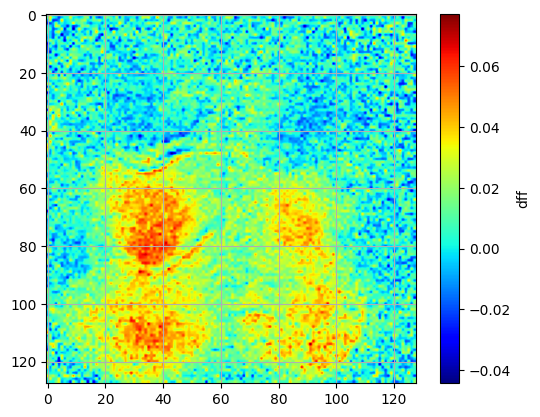

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:39,  3.20it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.27it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.34it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:35,  3.44it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:35,  3.48it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:34,  3.50it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:33,  3.61it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:35,  3.34it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:37,  3.18it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.08it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:38,  3.07it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.15it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.12it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.23it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.30it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:36,  3.03it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:35,  3.17it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:35,  3.13it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.20it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:32,  3.30it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:32,  3.32it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:31,  3.41it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:30,  3.43it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:30,  3.37it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:30,  3.37it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:29,  3.41it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:29,  3.37it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:28,  3.48it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.42it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.26it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.35it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.28it/s]

 26%|████████████████████▉                                                            | 33/128 [00:09<00:28,  3.39it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:27,  3.48it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:25,  3.59it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:26,  3.53it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:25,  3.51it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:26,  3.42it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:25,  3.52it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:26,  3.35it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:25,  3.36it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:26,  3.21it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:12<00:25,  3.30it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:25,  3.32it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:24,  3.37it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:24,  3.36it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:24,  3.29it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:24,  3.21it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:23,  3.40it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.35it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.30it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:22,  3.34it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:22,  3.37it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:22,  3.36it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:21,  3.41it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:22,  3.17it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.25it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:21,  3.33it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:20,  3.29it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.23it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:20,  3.35it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:19,  3.32it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:18<00:19,  3.32it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:19,  3.24it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:19,  3.20it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:19<00:19,  3.26it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:19,  3.11it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:18,  3.25it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:20<00:17,  3.37it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.37it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.34it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:17,  3.20it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:17,  3.17it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.18it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:16,  3.17it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:22<00:15,  3.31it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.34it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:14,  3.34it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:23<00:15,  3.23it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:15,  3.10it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:14,  3.15it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:24<00:14,  3.10it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.17it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.19it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:13,  3.29it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.23it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.31it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:12,  3.33it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:26<00:11,  3.34it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.22it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.30it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:27<00:10,  3.33it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.41it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:09,  3.49it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:28<00:09,  3.48it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.30it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.30it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:29<00:09,  3.25it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:29<00:08,  3.32it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.32it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:07,  3.39it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:30<00:07,  3.46it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.38it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.26it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:31<00:07,  3.22it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.36it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.28it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:32<00:06,  3.24it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:32<00:05,  3.29it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.31it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:04,  3.41it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:33<00:04,  3.23it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.35it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.35it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:34<00:03,  3.38it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.43it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.45it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:02,  3.37it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:35<00:02,  3.40it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.19it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.19it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:36<00:01,  3.24it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.36it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.47it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:37<00:00,  3.36it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.36it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.18it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.33it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.31it/s]

frame number 200 plotted


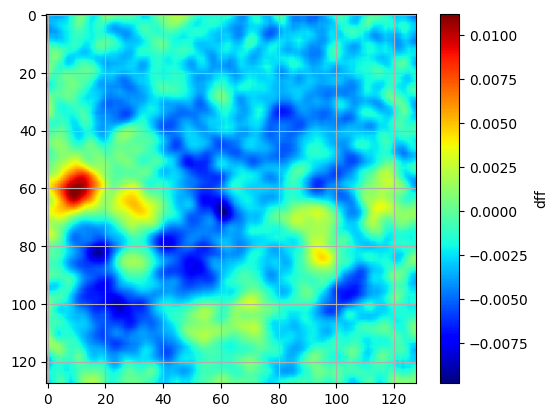

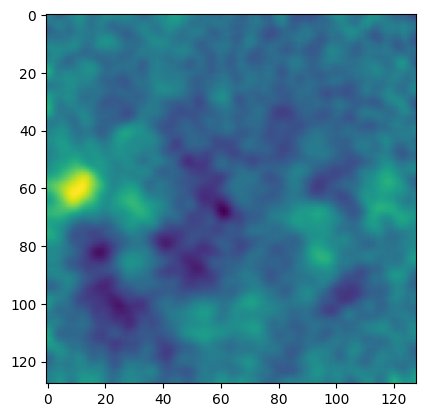

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 20


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 0
fail = 53
total trials = 53


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 25
fail = 2
total trials = 27


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 14
fail = 6
total trials = 20


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34271 [00:00<?, ?it/s]

  6%|████▋                                                                     | 2164/34271 [00:00<00:01, 21558.45it/s]

 13%|█████████▉                                                                | 4606/34271 [00:00<00:01, 23108.16it/s]

 21%|███████████████▎                                                          | 7103/34271 [00:00<00:01, 23850.17it/s]

 28%|████████████████████▍                                                     | 9488/34271 [00:00<00:01, 23038.95it/s]

 35%|█████████████████████████▊                                               | 12142/34271 [00:00<00:00, 24187.50it/s]

 43%|███████████████████████████████                                          | 14566/34271 [00:00<00:00, 22208.23it/s]

 49%|███████████████████████████████████▊                                     | 16815/34271 [00:00<00:00, 22028.23it/s]

 57%|█████████████████████████████████████████▎                               | 19413/34271 [00:00<00:00, 23148.15it/s]

 63%|██████████████████████████████████████████████▎                          | 21746/34271 [00:00<00:00, 22998.32it/s]

 71%|███████████████████████████████████████████████████▍                     | 24167/34271 [00:01<00:00, 23292.24it/s]

 77%|████████████████████████████████████████████████████████▍                | 26506/34271 [00:01<00:00, 21410.47it/s]

 84%|█████████████████████████████████████████████████████████████▏           | 28736/34271 [00:01<00:00, 21601.77it/s]

 91%|██████████████████████████████████████████████████████████████████▎      | 31105/34271 [00:01<00:00, 22137.61it/s]

 97%|███████████████████████████████████████████████████████████████████████  | 33339/34271 [00:01<00:00, 21634.99it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34271/34271 [00:01<00:00, 22357.06it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 20006.70it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22229.13it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")